In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import skimage.morphology
import os

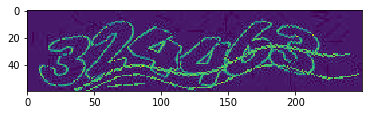

In [2]:
im = cv2.imread("images/full/324463.jpg")
a = np.asarray(im)
a = a[:,:,0]
a = a/255
a = 1-a
#a = a>0.1

plt.imshow(a)

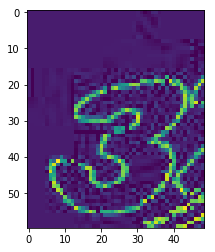

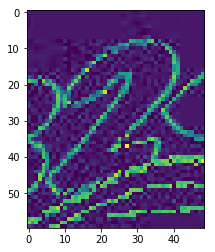

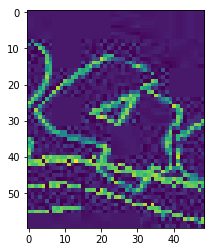

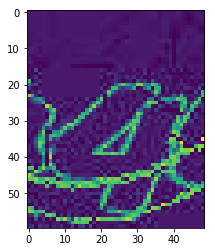

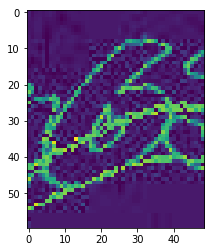

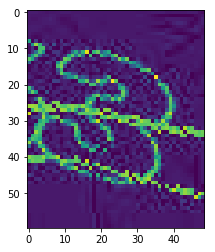

In [3]:
l = 10
r = 220

s = int((r-l)/6)

for i in range(6):
    plt.imshow(a[:, l + i*s-7: l + (i+1)*s + 7])
    plt.show()


In [4]:
def encode(c):
    if(ord('0')<= ord(c) <= ord('9')): return ord(c) -ord('0');
    else: return ord(c) - ord('a') + 10
    
def decode(c):
    if(c<10): return str(c)[1]
    else: return chr(c-10 + ord('a'))

decode(11)

'b'

In [5]:
#new_shape = (35,40)
new_shape = 60,49

loc = 'images/full'
folder = os.listdir(loc)

X = []
y = []

for image in folder:
    labels = image[:-4]
    if len(labels)!=6: continue
        
    image = loc + '/' + image
    im = cv2.imread(image)
    a = np.asarray(im)
    a = a[:,:,0]
    a = a/255
    a = 1-a
    
    if a.shape[0]!=60: continue;
    
    l = 10
    r = 230
    s = int((r-l)/6)

    for i in range(6):
        img = np.array(a[:, l + i*s-10: l + (i+1)*s + 10])
        #res = np.array(cv2.resize(img, dsize=new_shape, interpolation=cv2.INTER_CUBIC))
        X.append(img)
        y.append(encode(labels[i])) 




In [6]:
X = np.array(X)
y = np.array(y)

In [7]:
X.shape


(9126, 60, 56)

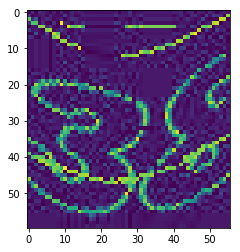

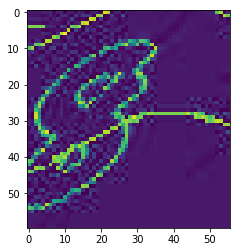

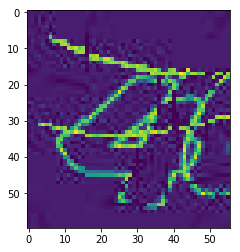

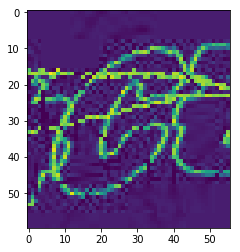

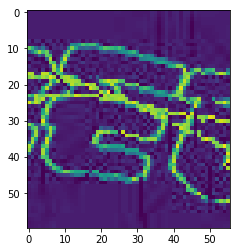

...

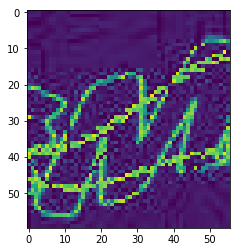

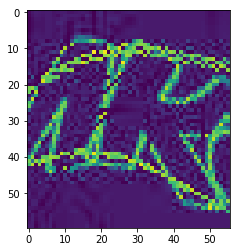

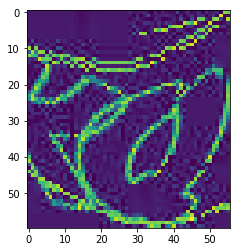

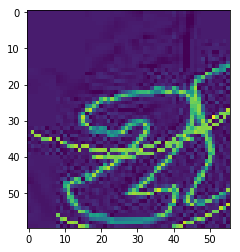

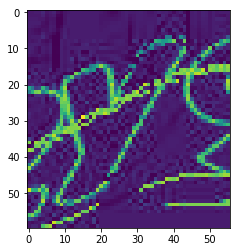

In [9]:
for i in range(700, 800):
    plt.imshow(X[i, :, :])
    plt.show()

In [10]:
from sklearn.model_selection import train_test_split
from keras.utils.np_utils import to_categorical 
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPool2D
from keras.optimizers import RMSprop, Adam
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ReduceLROnPlateau



Using TensorFlow backend.


In [11]:
X = X.reshape(-1, 60,56,1)
y = to_categorical(y)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1, random_state=2)

In [12]:
X_train.shape

(8213, 60, 56, 1)

In [13]:
model = Sequential()
model.add(Conv2D(filters = 64, kernel_size = (3,3), 
                 activation ='relu', input_shape = (60,56,1)))
model.add(Conv2D(filters = 64, kernel_size = (3,3), 
                 activation ='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(filters = 64, kernel_size = (3,3), 
                 activation ='relu'))
model.add(Conv2D(filters = 64, kernel_size = (3,3), 
                 activation ='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(filters = 64, kernel_size = (3,3), 
                 activation ='relu'))
model.add(Conv2D(filters = 64, kernel_size = (3,3), 
                 activation ='relu'))
model.add(MaxPool2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(256, activation = "relu"))
model.add(Dropout(0.5))
model.add(Dense(36, activation = "softmax"))

print(model.summary())

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 58, 54, 64)        640       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 56, 52, 64)        36928     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 28, 26, 64)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 28, 26, 64)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 26, 24, 64)        36928     
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 24, 22, 64)        36928     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 12, 11, 64)        0         
__________

In [14]:
optimizer = Adam()
model.compile(optimizer = optimizer , loss = "categorical_crossentropy", metrics=["accuracy"])
epochs = 30
batch_size = 8
learning_rate_reduction = ReduceLROnPlateau(monitor='val_acc', 
                                            patience=3, 
                                            verbose=1, 
                                            factor=0.1, 
                                            min_lr=0.00001)

In [15]:
final = model.fit(X_train, y_train, batch_size = batch_size, epochs = 10, validation_data = (X_test, y_test),callbacks=[learning_rate_reduction])
#results = model.predict(test)

Train on 8213 samples, validate on 913 samples
Epoch 1/10
8213/8213 [==============================] - 296s 36ms/step - loss: 3.2706 - acc: 0.0451 - val_loss: 3.2409 - val_acc: 0.0394
Epoch 2/10
8213/8213 [==============================] - 283s 35ms/step - loss: 2.7987 - acc: 0.1618 - val_loss: 1.8186 - val_acc: 0.5181
Epoch 3/10
8213/8213 [==============================] - 283s 34ms/step - loss: 1.3245 - acc: 0.5962 - val_loss: 0.5100 - val_acc: 0.8521
Epoch 4/10
8213/8213 [==============================] - 282s 34ms/step - loss: 0.6310 - acc: 0.8054 - val_loss: 0.2694 - val_acc: 0.9288
Epoch 5/10
8213/8213 [==============================] - 293s 36ms/step - loss: 0.4106 - acc: 0.8774 - val_loss: 0.1860 - val_acc: 0.9474
Epoch 6/10
8213/8213 [==============================] - 292s 36ms/step - loss: 0.3117 - acc: 0.9078 - val_loss: 0.1586 - val_acc: 0.9507
Epoch 7/10
8213/8213 [==============================] - 299s 36ms/step - loss: 0.2541 - acc: 0.9249 - val_loss: 0.1247 - val_acc: 0

KeyboardInterrupt: 

In [102]:
datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range=10, # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.05, # Randomly zoom image 
        width_shift_range=0.10,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.10,  # randomly shift images vertically (fraction of total height)
        horizontal_flip=False,  # randomly flip images
        vertical_flip=False)  # randomly flip images
        
datagen.fit(X_train)

h = model.fit_generator(datagen.flow(X_train, y_train, batch_size = 16),
                              epochs = 100, validation_data = (X_test , y_test),
                              steps_per_epoch=10,  # // batch_size
                              callbacks=[learning_rate_reduction]), 

Epoch 1/100
10/10 [==============================] - 8s 794ms/step - loss: 1.0824 - acc: 0.7375 - val_loss: 0.1919 - val_acc: 0.9449
Epoch 2/100
10/10 [==============================] - 9s 861ms/step - loss: 0.9291 - acc: 0.7375 - val_loss: 0.2338 - val_acc: 0.9423
Epoch 3/100
10/10 [==============================] - 8s 780ms/step - loss: 0.6554 - acc: 0.7937 - val_loss: 0.2091 - val_acc: 0.9449
Epoch 4/100
10/10 [==============================] - 9s 851ms/step - loss: 0.8342 - acc: 0.7562 - val_loss: 0.1868 - val_acc: 0.9501
Epoch 5/100
10/10 [==============================] - 8s 792ms/step - loss: 0.6015 - acc: 0.8490 - val_loss: 0.1743 - val_acc: 0.9554
Epoch 6/100
10/10 [==============================] - 9s 903ms/step - loss: 0.6704 - acc: 0.7625 - val_loss: 0.2236 - val_acc: 0.9423
Epoch 7/100
 1/10 [==>...........................] - ETA: 4s - loss: 0.1891 - acc: 1.0000

KeyboardInterrupt: 

array([23, 28,  5,  1, 14, 20,  4, 14,  6,  6, 35,  5,  2, 33, 17, 20, 26,
        7, 10, 14,  3,  9,  1,  7, 16, 12,  8,  5,  9,  2,  8,  6,  9,  5,
        2, 26, 17, 25, 33,  4,  6, 25, 22,  4,  8,  5,  5, 17,  8,  9,  6,
       26, 20,  5,  5,  7, 13, 12, 17,  9, 30, 31,  8,  9,  4, 20, 16, 33,
        4,  4,  5,  8,  1,  9,  4,  9,  3,  2,  9, 20,  5,  5,  5, 33,  3,
        2,  3,  4,  8, 31, 34,  6,  4,  3, 13,  5, 14,  5,  6,  1, 16, 31,
       28, 28,  4, 35, 34, 28,  8,  8, 33,  6,  8, 16, 35, 26, 35, 13,  3,
        5, 33,  4, 35,  4,  9,  1,  8, 31, 10,  3,  3,  9,  9,  2,  6,  4,
        4,  3,  3,  9,  5, 34, 23,  3,  9,  8,  3,  3, 17,  1,  9, 14,  3,
        2,  2, 33, 13,  3, 14, 33,  8,  6,  4,  3,  5,  4, 33,  4,  6,  8,
       33,  1,  3, 22,  7, 22, 25,  7, 35, 10,  7, 34, 26, 33, 26])

In [53]:
from sklearn.metrics import classification_report
y_pred = model.predict(X_test)
print(classification_report(y_test.argmax(axis = 1), y_pred.argmax(axis = 1))
#classification_report(y_test, y_pred)


SyntaxError: unexpected EOF while parsing (<ipython-input-53-280cf6706156>, line 4)

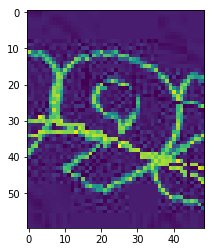

In [16]:
plt.imshow(img)

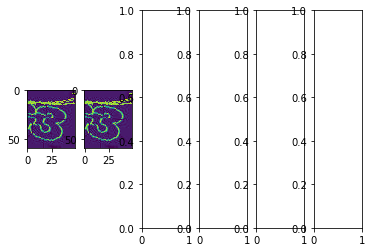

In [31]:
fig, ax = plt.subplots(1,6)
#ax[0, 0].plot(range(10), 'r') #row=0, col=0
ax[0].imshow(img)
ax[1].imshow(img)


In [36]:
a

array([[0.02745098, 0.08235294, 0.05098039, ..., 0.04313725, 0.04313725,
        0.04313725],
       [0.03137255, 0.        , 0.03921569, ..., 0.04313725, 0.04313725,
        0.04313725],
       [0.05098039, 0.14901961, 0.06666667, ..., 0.04313725, 0.04313725,
        0.04313725],
       ...,
       [0.03529412, 0.04705882, 0.03137255, ..., 0.04313725, 0.04313725,
        0.04313725],
       [0.04313725, 0.05098039, 0.03529412, ..., 0.04313725, 0.04313725,
        0.04313725],
       [0.04705882, 0.05490196, 0.03921569, ..., 0.04313725, 0.04313725,
        0.04313725]])

u2cxg3


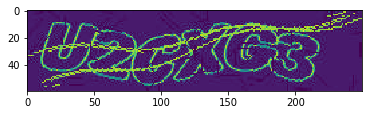

u2cxg3


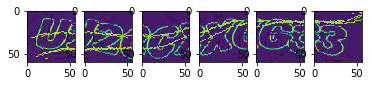

6sgppv


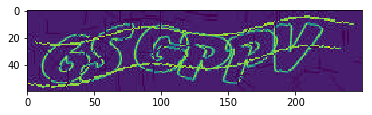

6sgppv


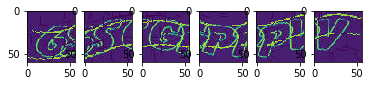

987469


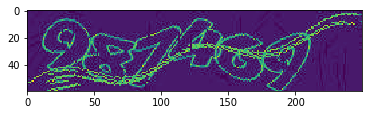

987469


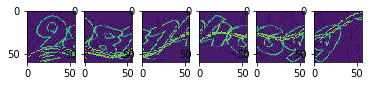

hadxqk


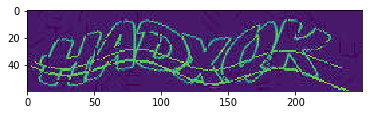

hadxqk


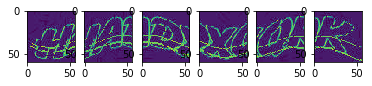

8c8g9g


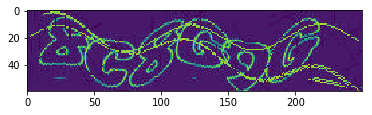

8c8g9g


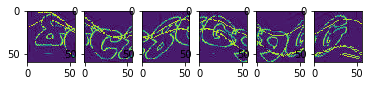

sqdkk9


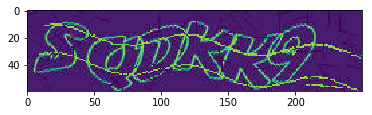

sqdkk9


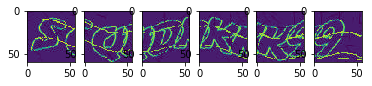

827185


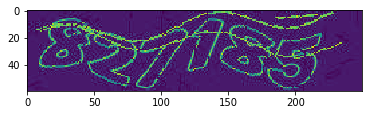

827185


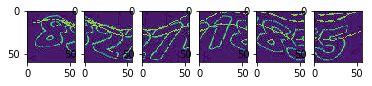

4vp3x4


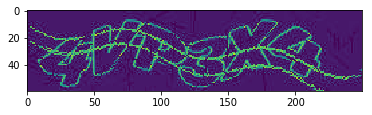

4vp3x4


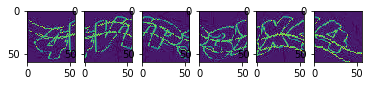

ae3k8z


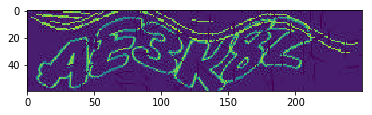

ae3k8z


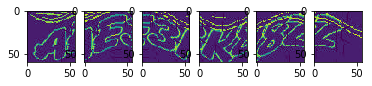

nqg9ag


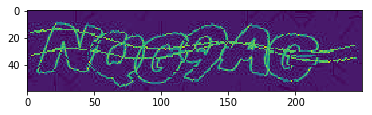

nqg9ag


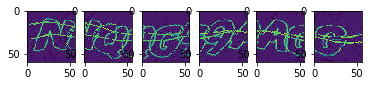

cvh2ze


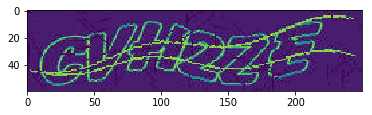

cvh2ze


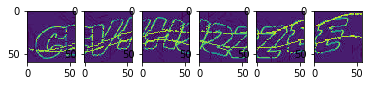

q4u2v6


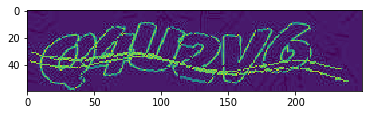

q4u2v6


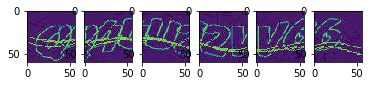

c4hvk2


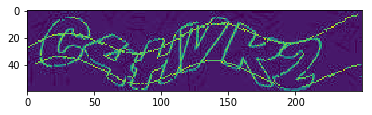

z4hvk2


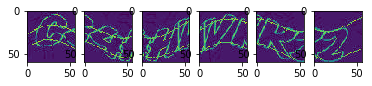

cs2xh3


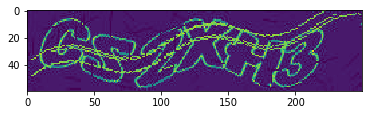

cs2xh3


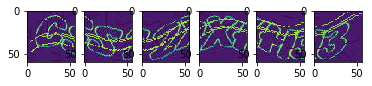

351777


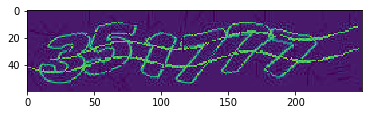

351777


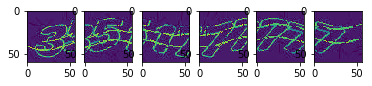

284823


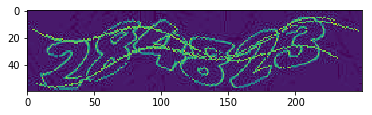

284823


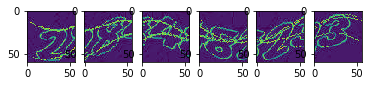

zv5vm5


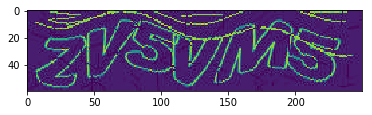

zv5vm5


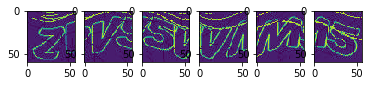

umdvm8


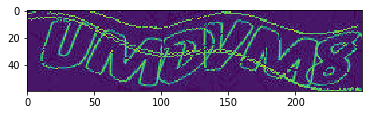

umdvm8


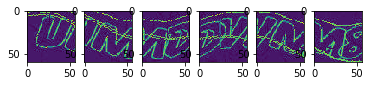

quuxuk


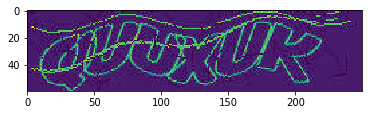

quuquk


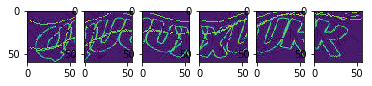

8xnse6


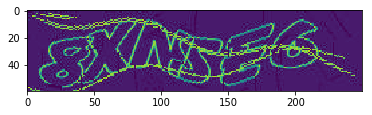

8xnse6


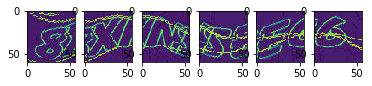

d3mh9n


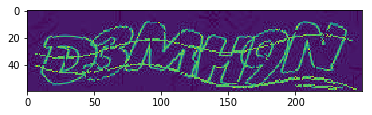

d3mh9n


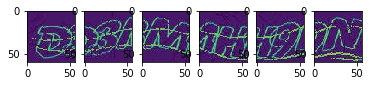

3g8kxy


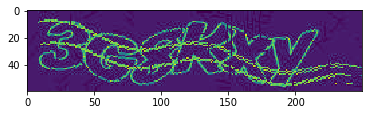

3g8kxy


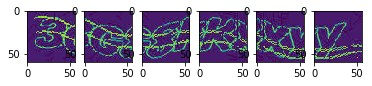

898992


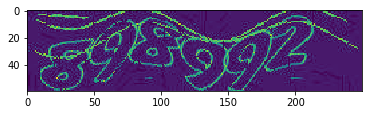

898992


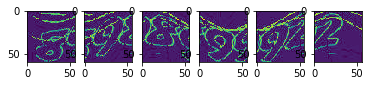

a8vs59


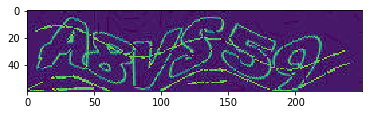

a8vs59


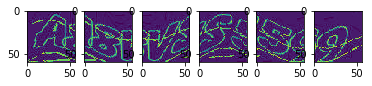

998238


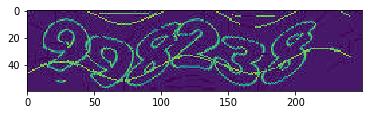

998238


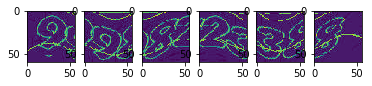

868849


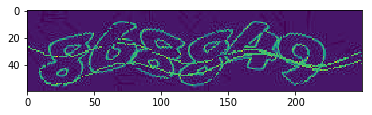

868849


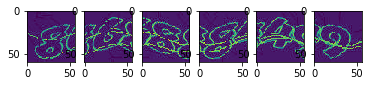

242899


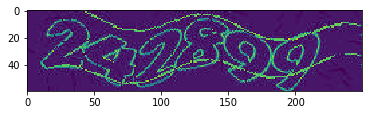

242899


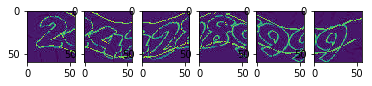

dxvh63


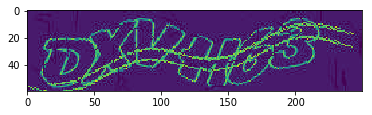

dxvh63


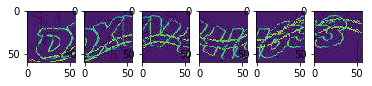

9926as


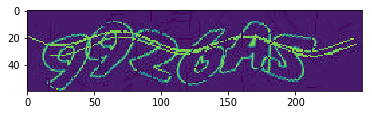

9926as


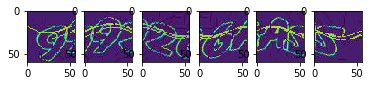

a38mkq


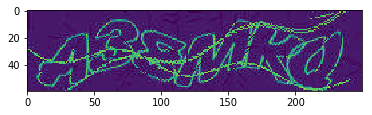

a38mkq


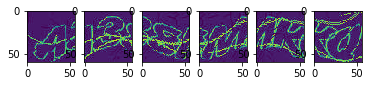

k6g9s9


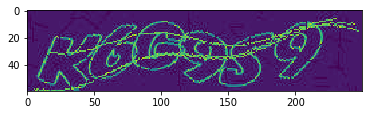

k6g9s9


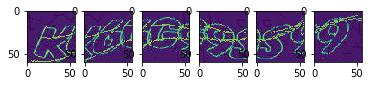

878535


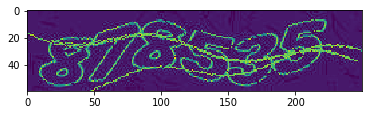

878535


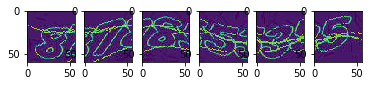

653381


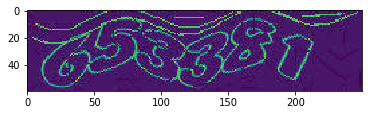

653381


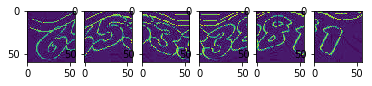

mvpsss


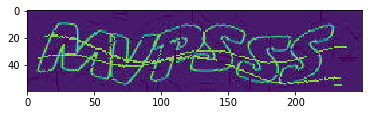

mvpsss


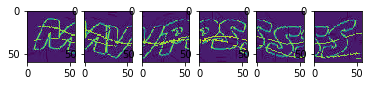

nm2v2m


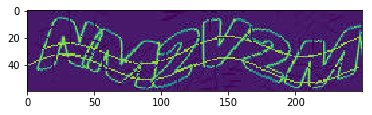

nm2v2m


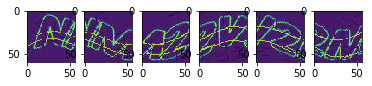

39dqnz


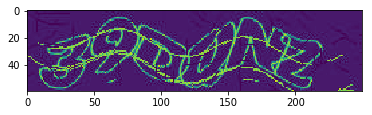

39dqnz


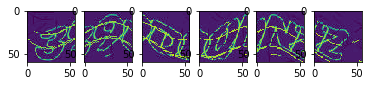

4y4avy


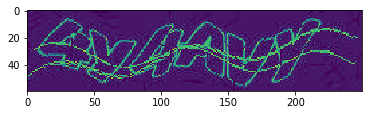

4y4avy


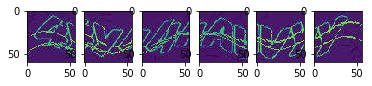

pgvmzm


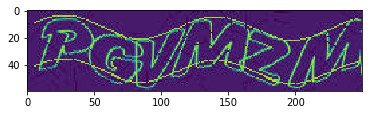

pgvmzm


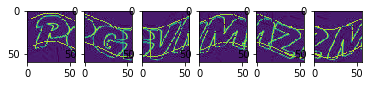

eyzcde


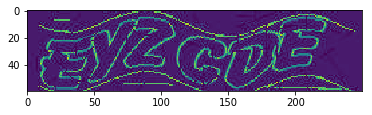

eyzcde


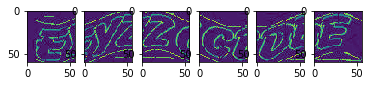

221536


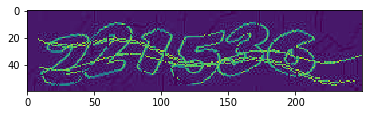

221536


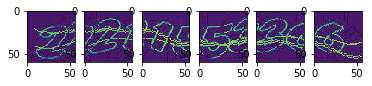

678918


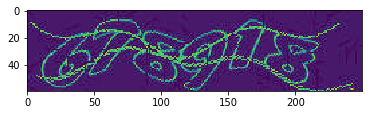

678918


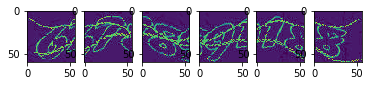

ygapx5


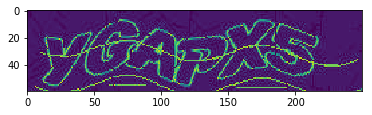

ygapx5


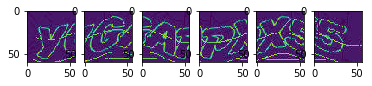

e8dhe5


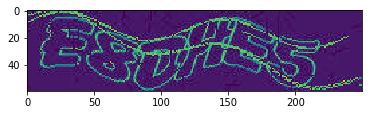

e8dhe5


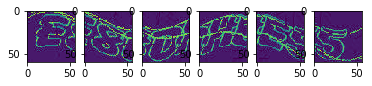

p3uzd4


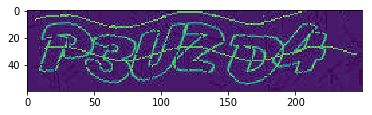

p3uzd4


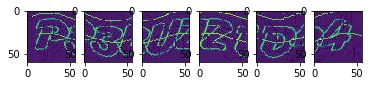

713363


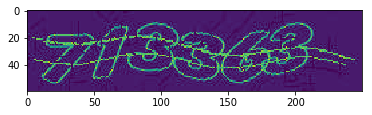

713363


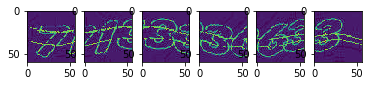

k599zg


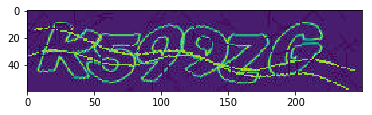

k599zg


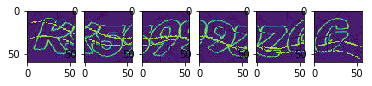

y45z6x


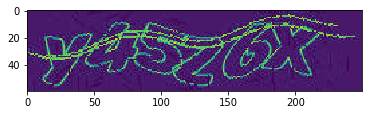

y45z6x


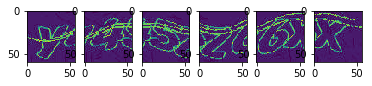

n9vpqq


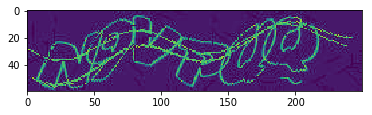

n9vpqq


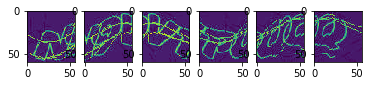

v4n8zg


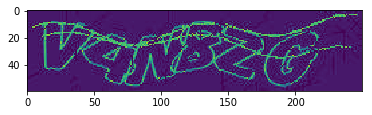

v4n8zg


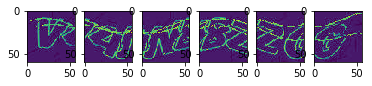

2ex53c


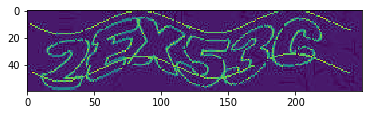

2ex53c


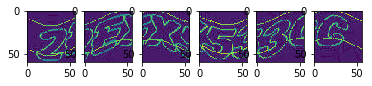

685932


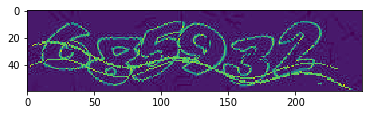

685932


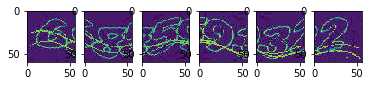

9d455p


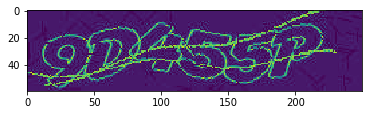

9d455p


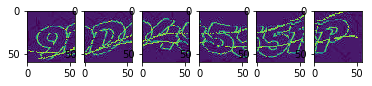

272354


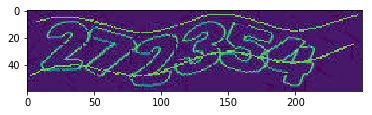

272354


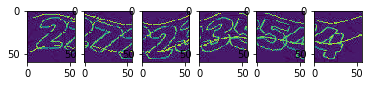

duaz9a


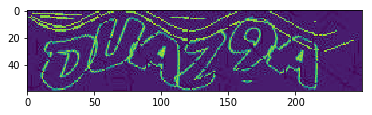

duaz9a


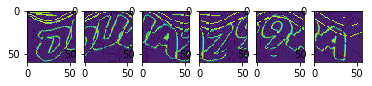

865944


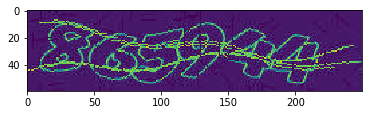

865944


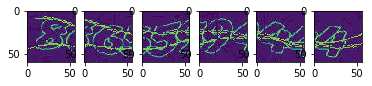

449365


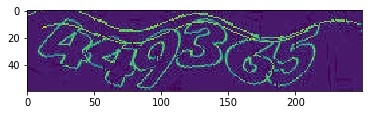

449365


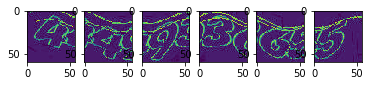

uk94xz


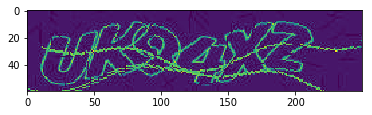

uk94xz


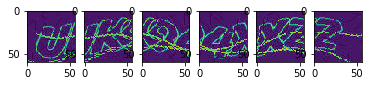

ksgh3x


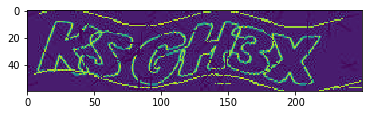

ksgh3x


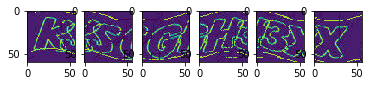

d8pmuy


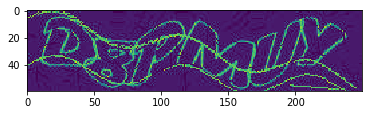

d8pmuy


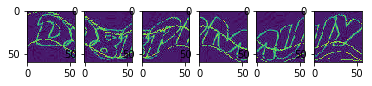

324463


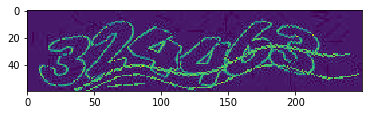

324463


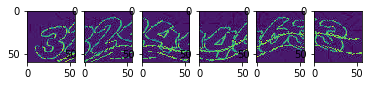

133825


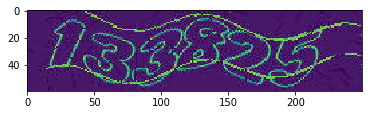

133825


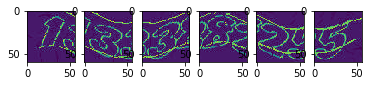

yhkamc


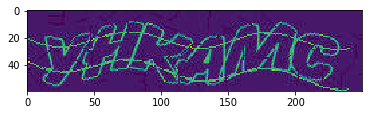

yhkamc


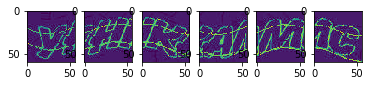

g63p63


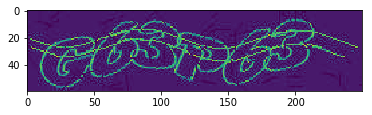

g63p63


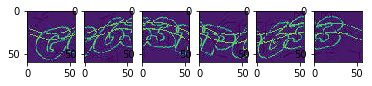

4mpguu


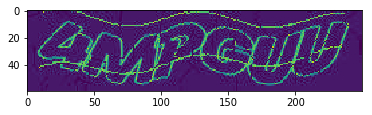

4mpguu


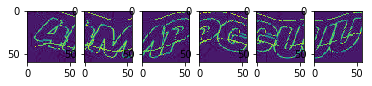

vx3q96


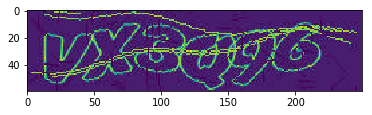

vx3q96


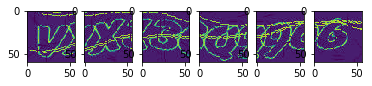

qekkes


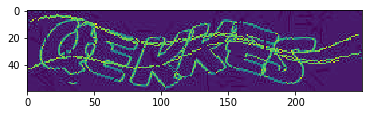

qekkes


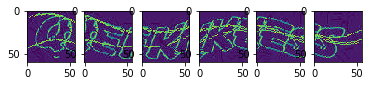

uyak6g


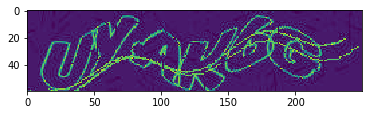

uyak6g


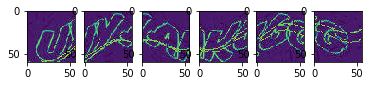

zd8q39


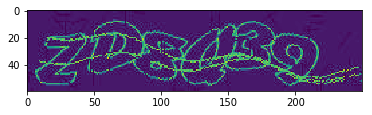

zd8q39


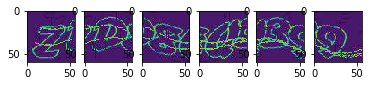

v4egy5


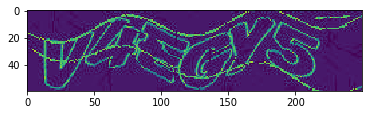

v4egy5


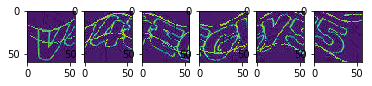

ucxcn3


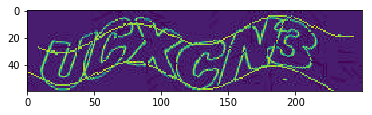

ucxcn3


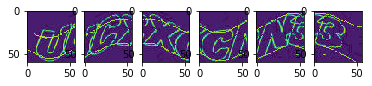

sgy4v9


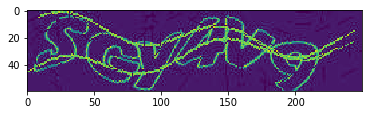

sgy4v9


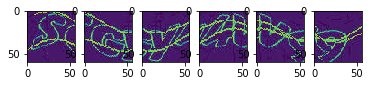

s4kp6s


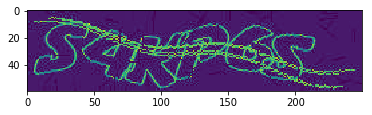

s4kp6s


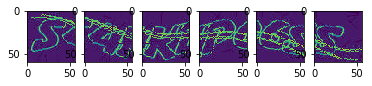

282852


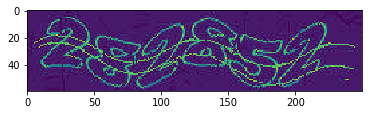

282852


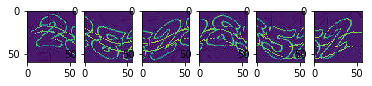

mx2c5y


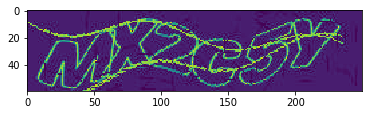

mx2c5y


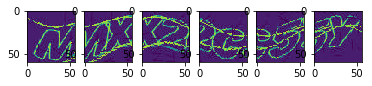

d6hqcz


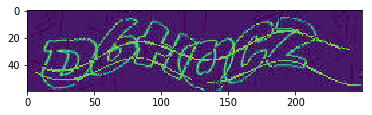

d6hqcz


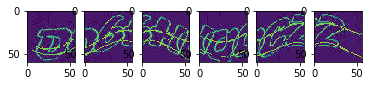

956584


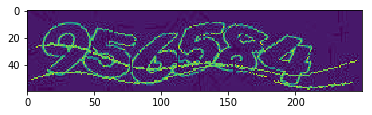

956584


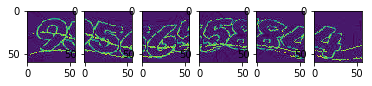

566227


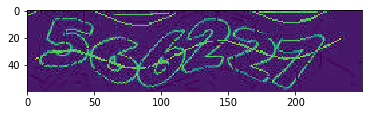

566227


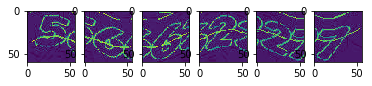

nm2eds


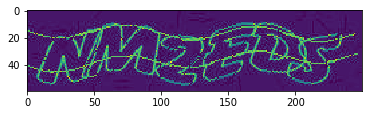

nm2eds


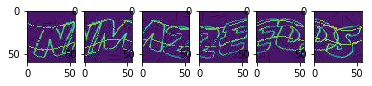

p8puqv


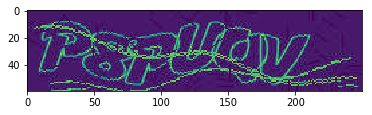

p8puuv


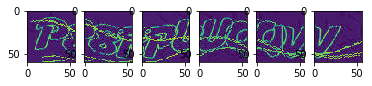

245855


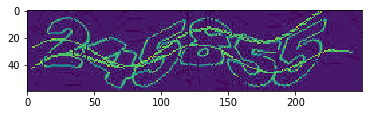

245855


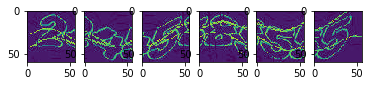

qxzsuu


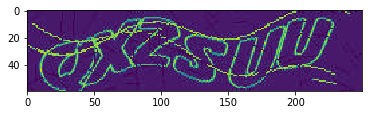

qxzsuu


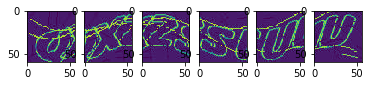

zdagvz


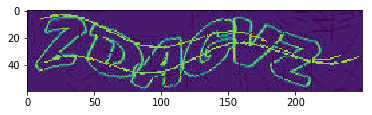

zdagvz


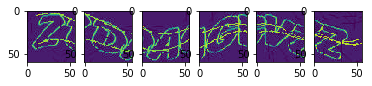

99ph8z


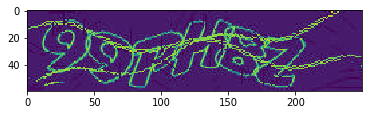

99ph8z


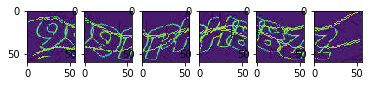

apq8gk


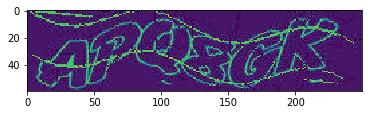

apq8gk


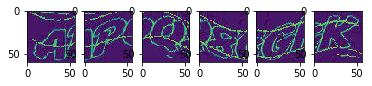

4unaqs


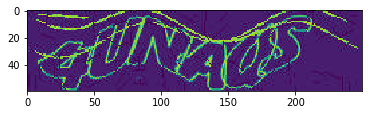

4unaqs


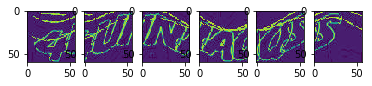

712133


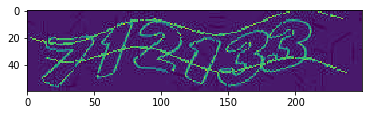

712133


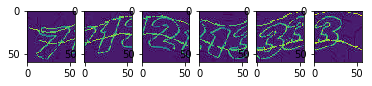

867348


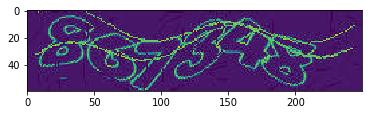

867348


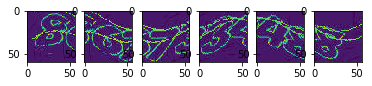

992114


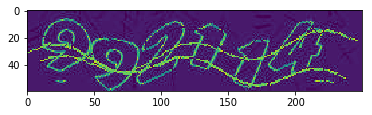

992114


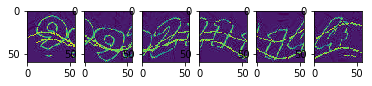

669797


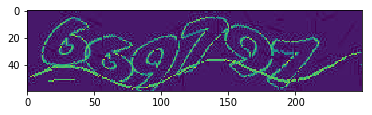

66979z


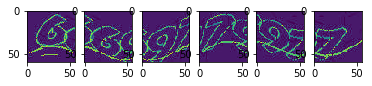

6mdh8m


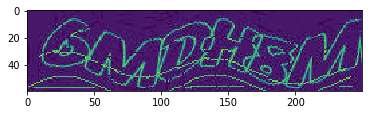

6mda8m


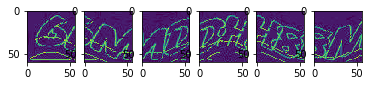

gy5kcy


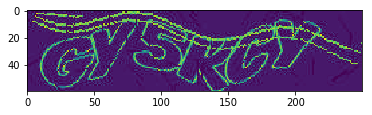

gy5kcy


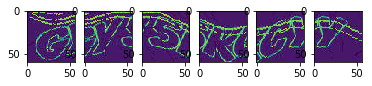

yy4yuq


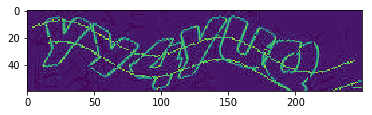

yy4yuq


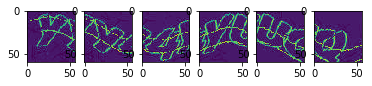

mh8d53


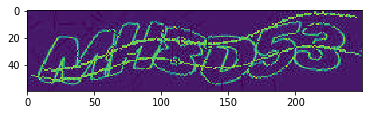

mh8d83


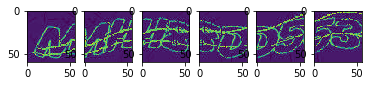

nhh4zp


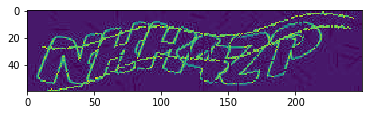

nhh4zp


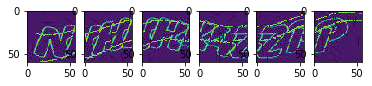

s2peux


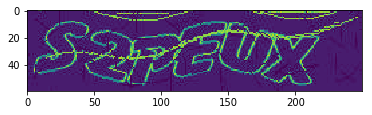

s2peux


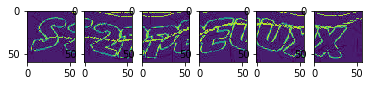

phqv2z


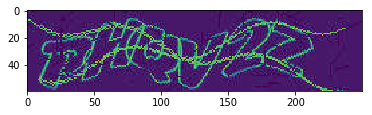

phqv2z


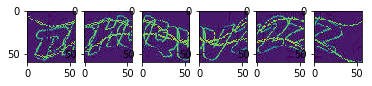

2gghk3


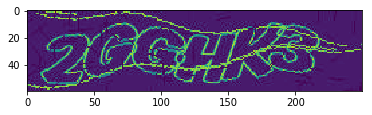

2gghk3


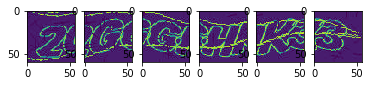

gxagu9


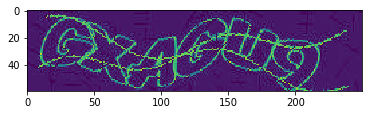

gxagu9


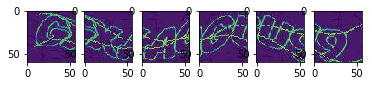

pgpxnp


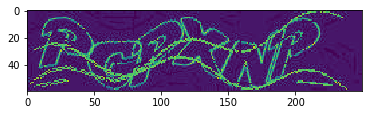

pgpxnp


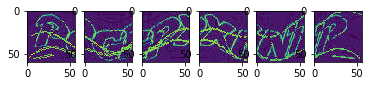

562769


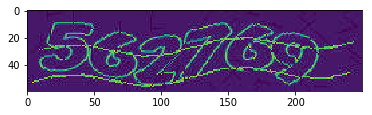

562769


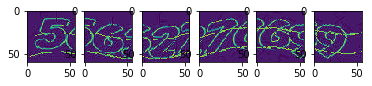

vkeqqy


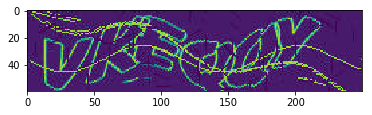

vkeqqy


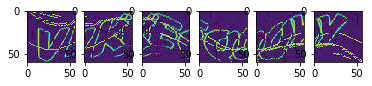

169391


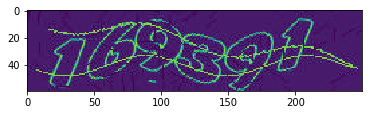

169391


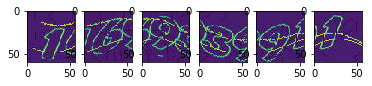

4c3yqn


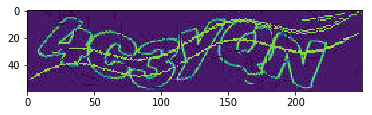

4c3yqn


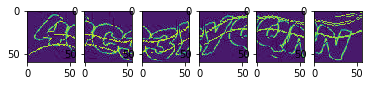

kk9dx4


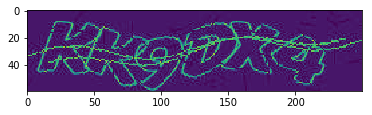

kk9dx4


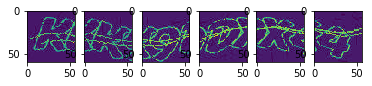

174465


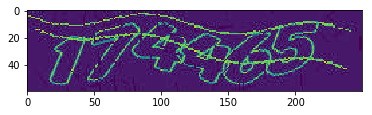

174465


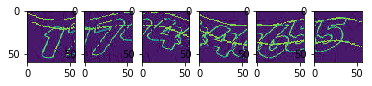

qmuuv5


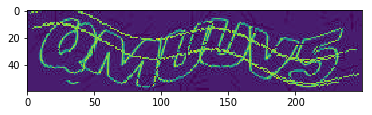

qmuuv5


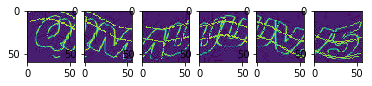

svana9


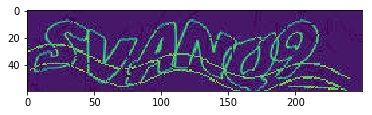

svana9


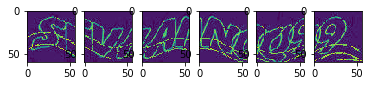

yxgmhk


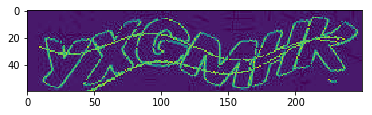

yxgmhk


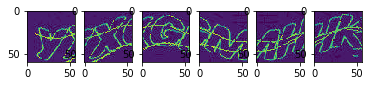

2zkva2


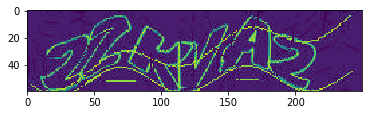

2zkva2


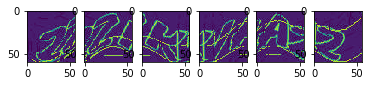

zh9qhz


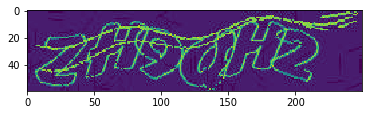

zh9qhz


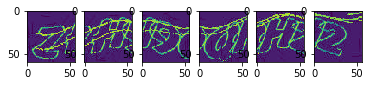

d63xy4


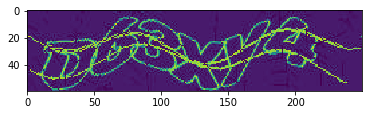

d63xy4


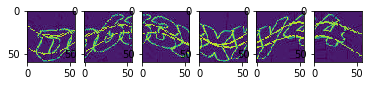

641256


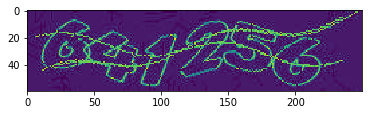

641256


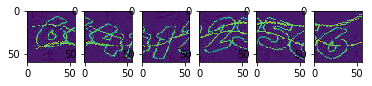

6cnx9x


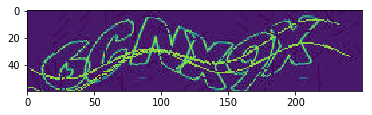

6cnx9x


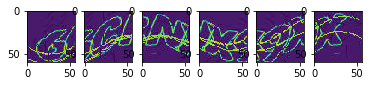

uzxs6h


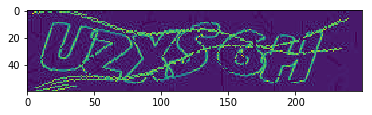

uzxs6h


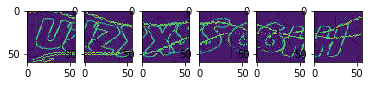

xye2kp


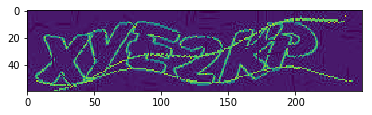

xye2kp


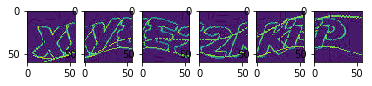

s8hssq


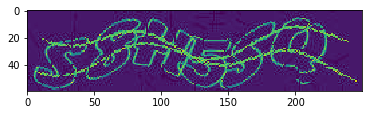

s8hssq


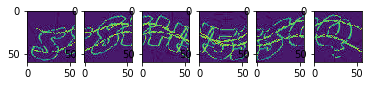

541576


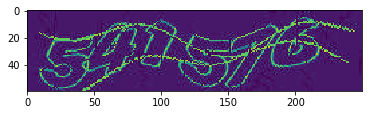

541576


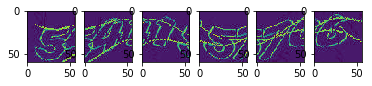

195249


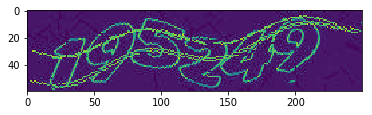

195249


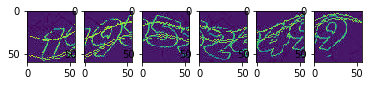

69uvuq


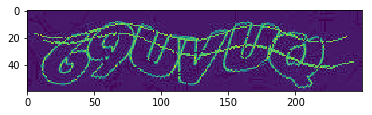

69uvuq


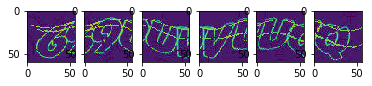

a85zvn


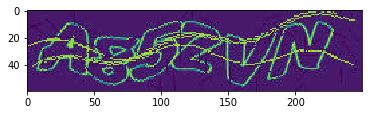

a85zvn


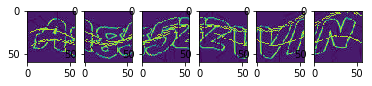

5ygz4q


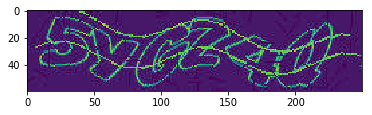

5ygz4q


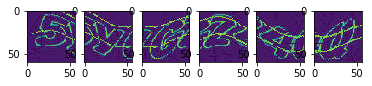

115887


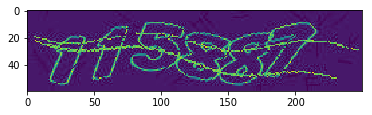

115887


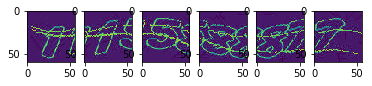

c3szxx


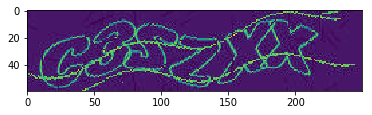

c3szxx


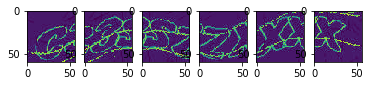

3vuyzn


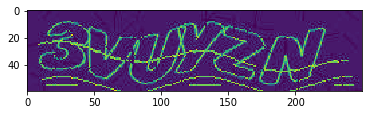

3vuyzn


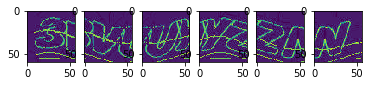

mqavx4


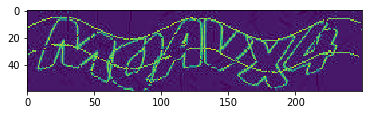

mqavx4


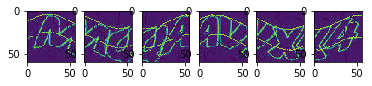

e2gmh8


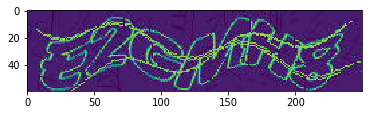

e2gmh8


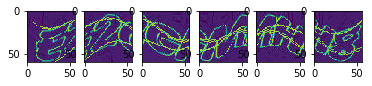

z4nnpx


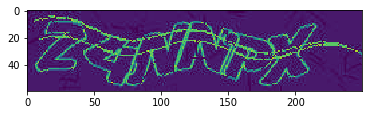

z4nnpx


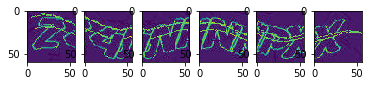

vvuk3y


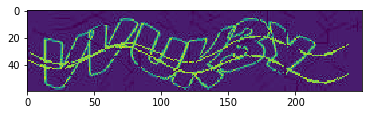

vvuk3y


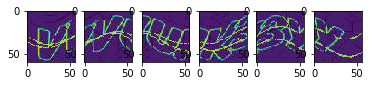

3zm8g9


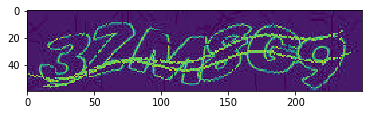

3zm8g9


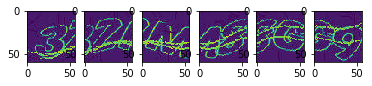

978191


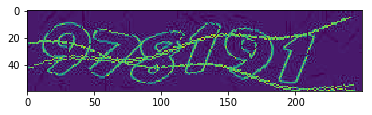

978191


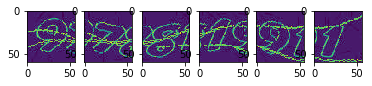

dzuech


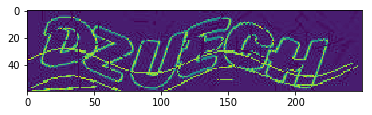

dzuech


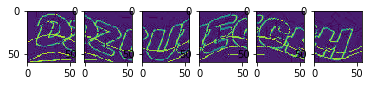

668758


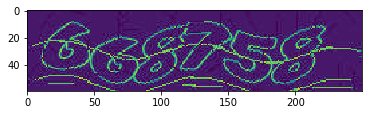

668758


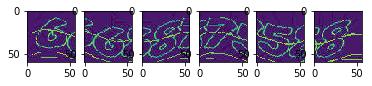

961365


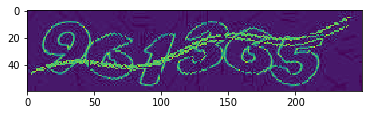

961365


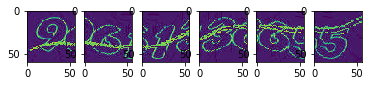

34yvyq


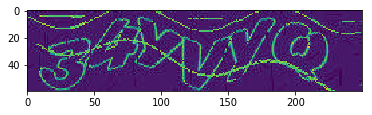

34yvyq


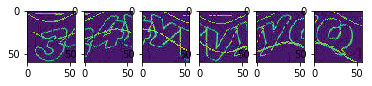

643p56


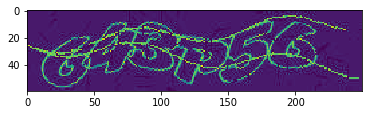

643p56


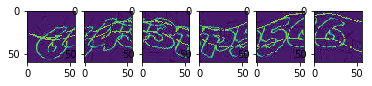

396473


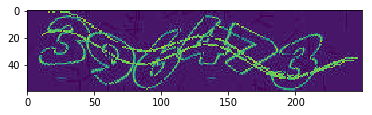

396473


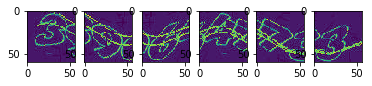

879728


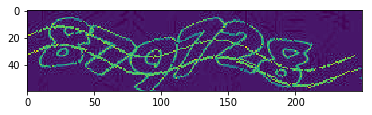

879728


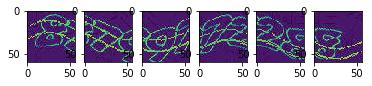

736591


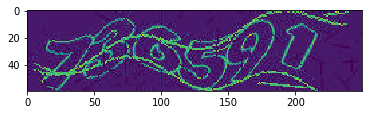

736591


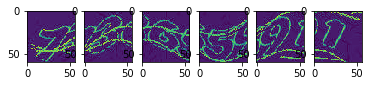

9qmcm9


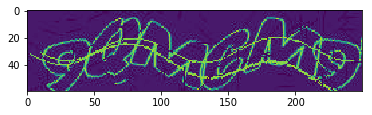

9qmgm9


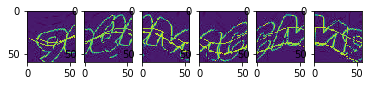

523865


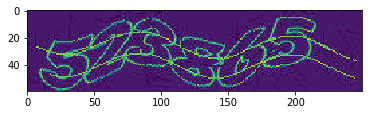

523865


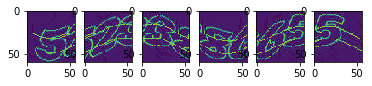

937916


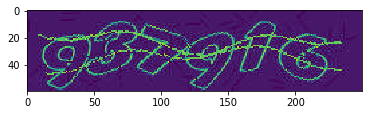

937916


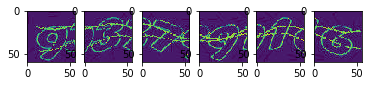

2z6qvg


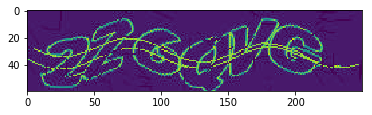

2z6qvg


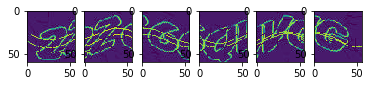

e25hxp


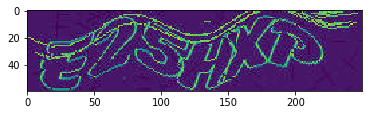

e25hxp


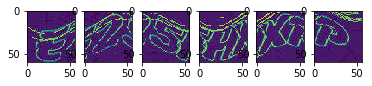

772648


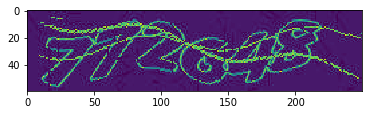

772648


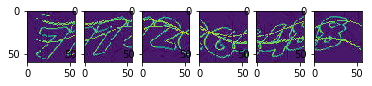

ehnk84


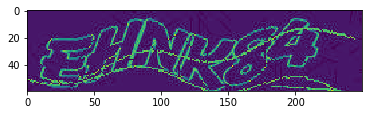

ehnk84


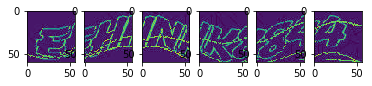

732721


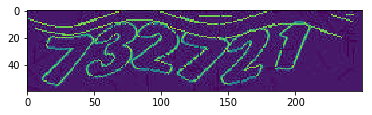

732721


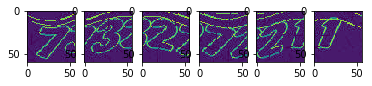

539814


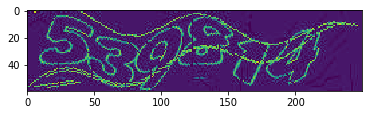

539814


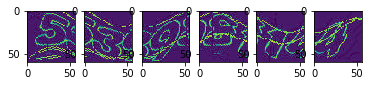

hqazyu


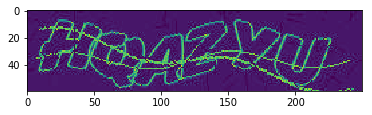

hqazyu


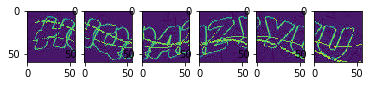

as49g6


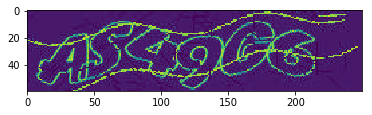

as49g6


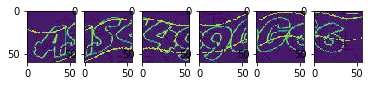

876585


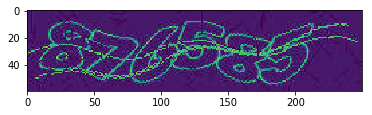

876585


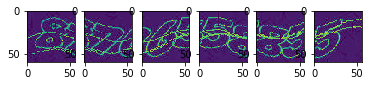

hdmpze


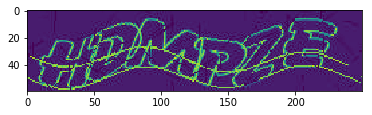

hdmp2e


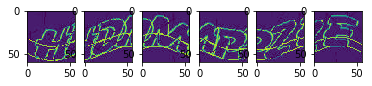

uzqnuq


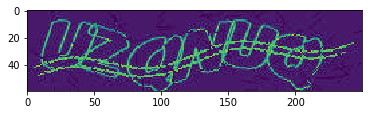

uzqnuq


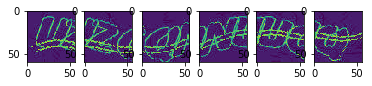

y62y28


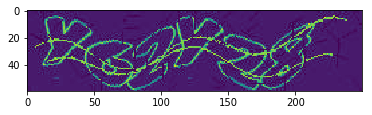

y62y28


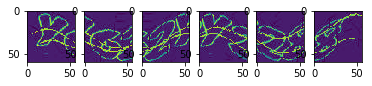

mg3su6


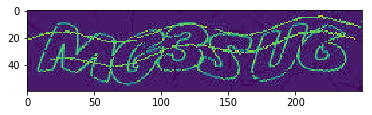

mg3su6


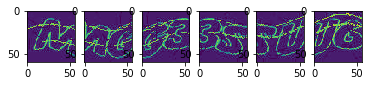

hdes8a


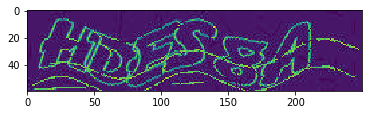

hdes8a


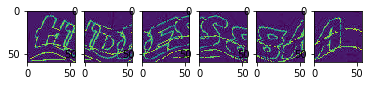

4h2azg


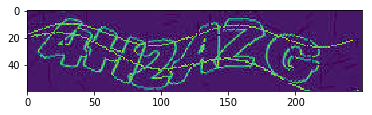

4h2azg


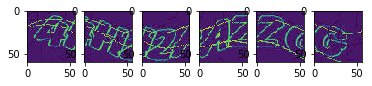

122392


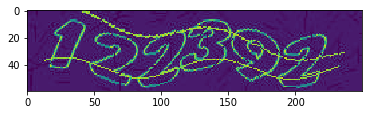

122392


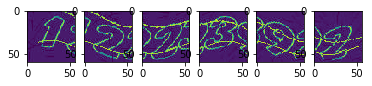

vcn6cs


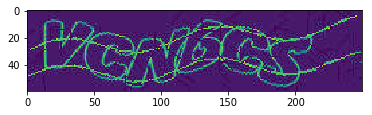

vcn6cs


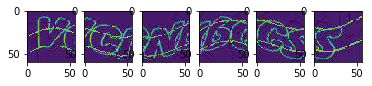

687565


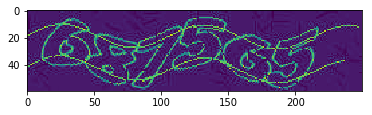

687565


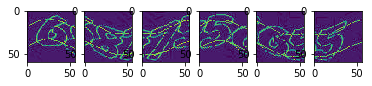

62v2ze


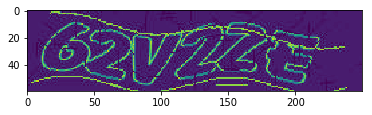

62v2ze


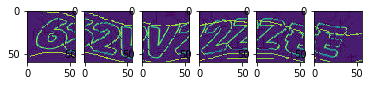

719198


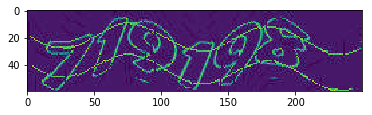

7191z8


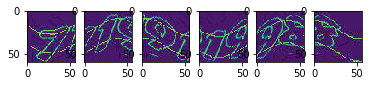

8uvscy


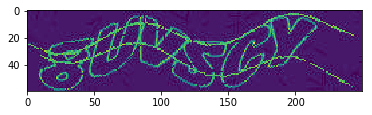

8uvecy


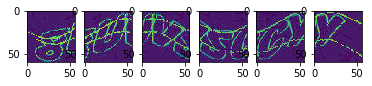

v2k9d5


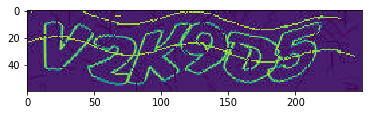

v2k9d5


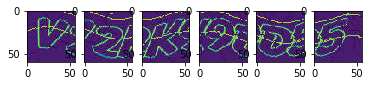

86mu6c


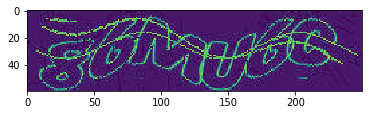

86mu6c


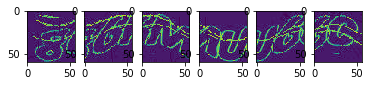

272733


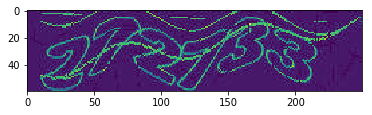

272733


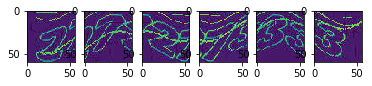

5y54y3


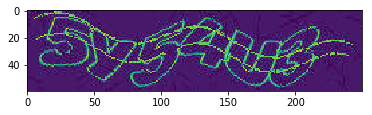

5y54u3


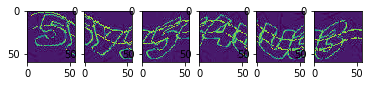

nsspe5


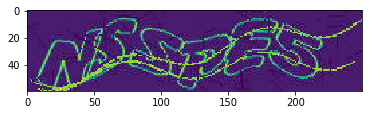

nsspe5


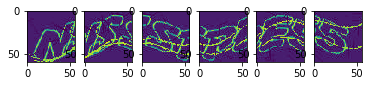

2dmazu


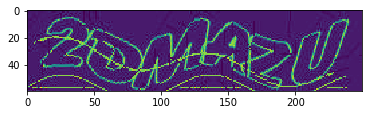

2dmazu


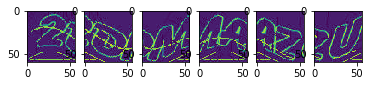

6qng3g


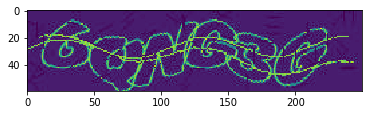

6qng3g


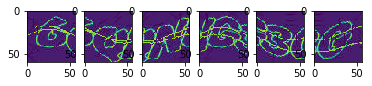

9pseec


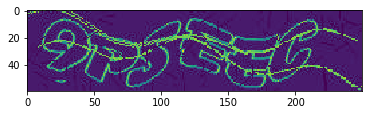

9pseec


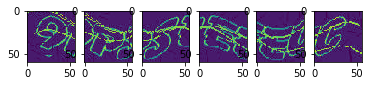

uez492


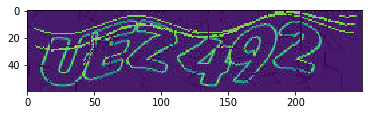

uez492


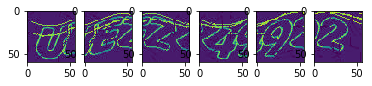

ek828p


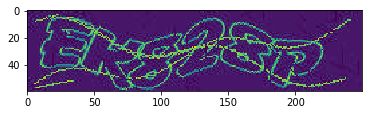

ek828p


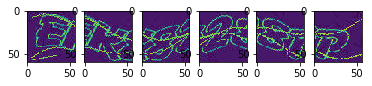

a9pdmz


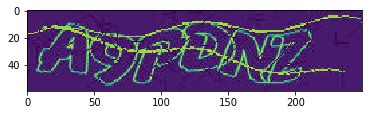

a9pdmz


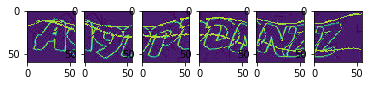

5d6y4k


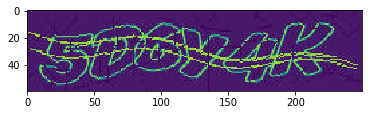

5d6y4k


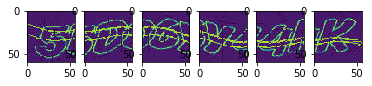

911527


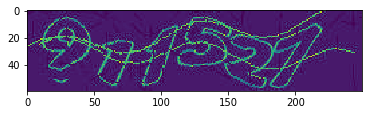

911527


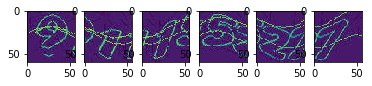

589693


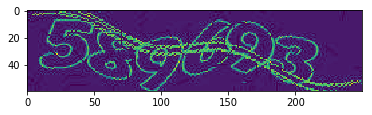

589693


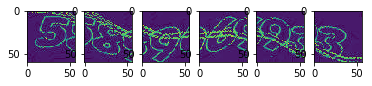

9c2py3


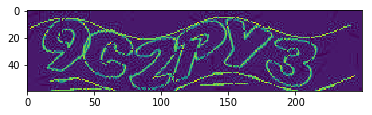

9c2py3


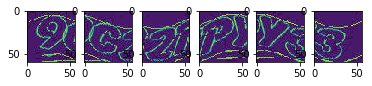

3gv64g


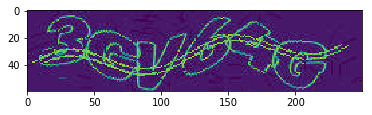

3gv64g


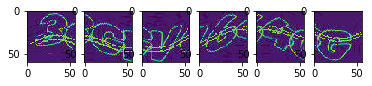

413829


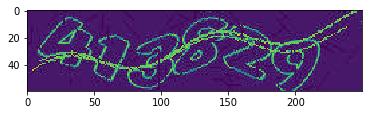

413829


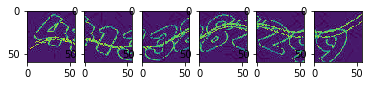

96zc59


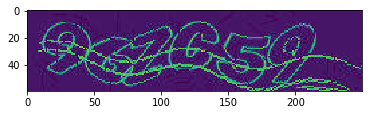

96zc59


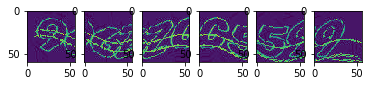

zqvdsy


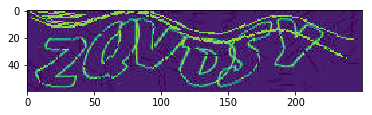

zqvdsy


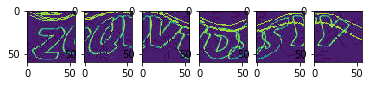

g6y4e8


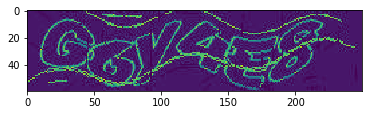

g6y4e8


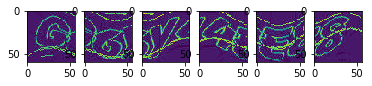

4u8mkv


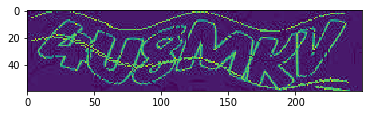

4u8mkv


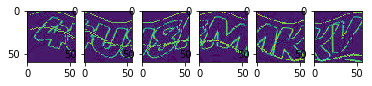

542696


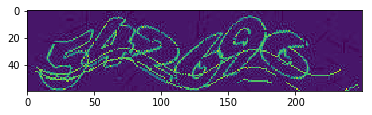

542696


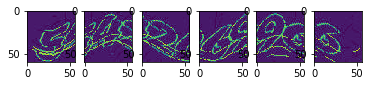

559261


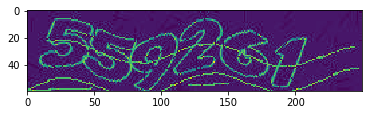

559261


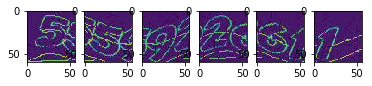

2mnzkq


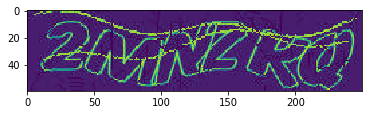

2mnzkq


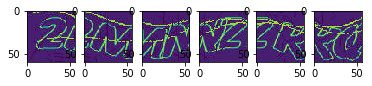

hgcxsa


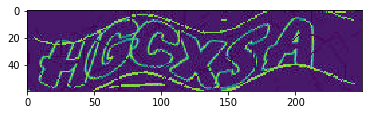

hgcxsa


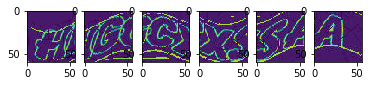

962332


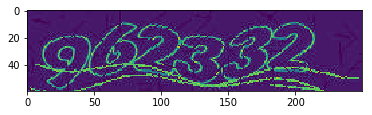

962332


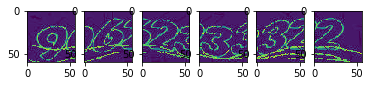

pv2hca


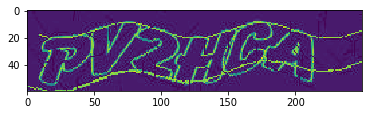

pv2hca


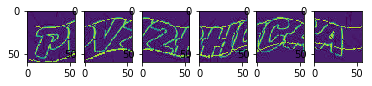

yp6m5p


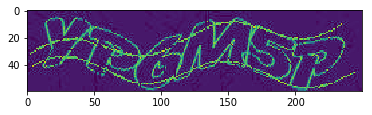

yp6m5p


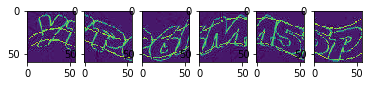

368191


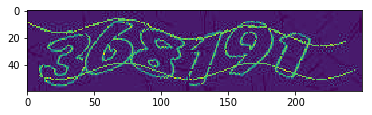

368191


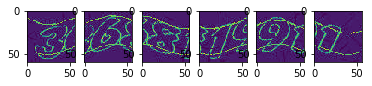

5zax84


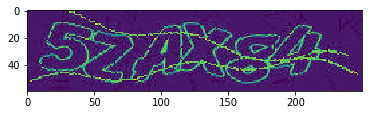

5zax84


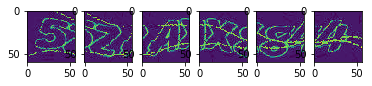

pe2z68


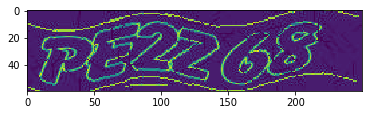

pe2z68


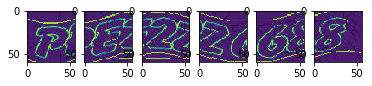

ad5z4p


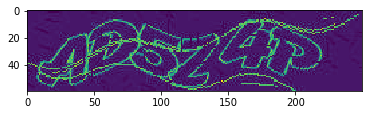

ad5z4p


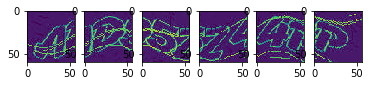

824987


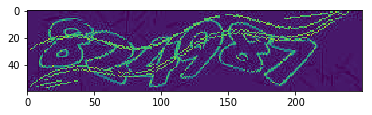

824987


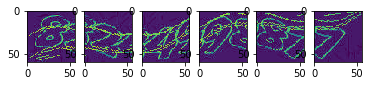

v5gg2n


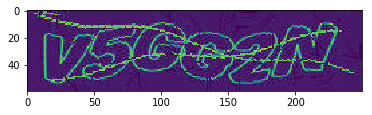

v5gg2n


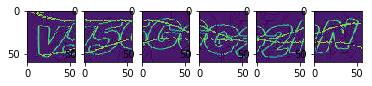

nzyvvd


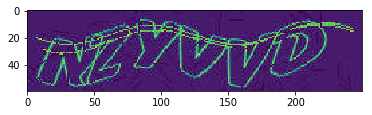

nzyvvd


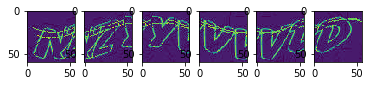

ugcamx


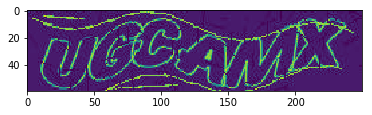

ugcamx


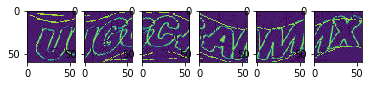

988846


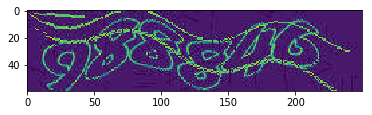

988846


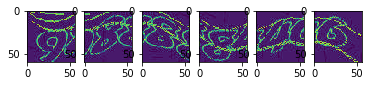

677521


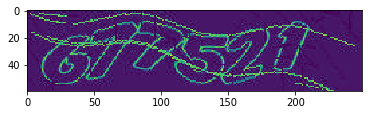

677521


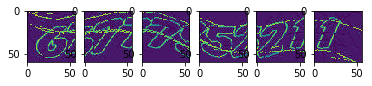

833785


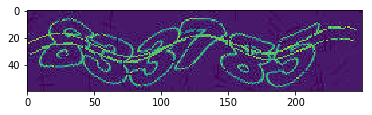

833785


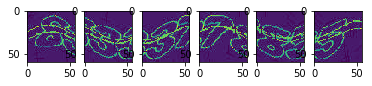

c3hcs5


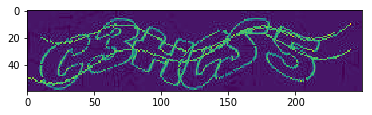

c3hcs5


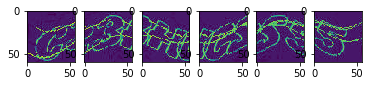

95ucz2


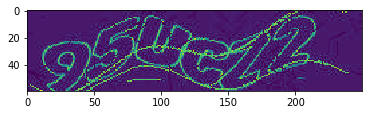

95ucz2


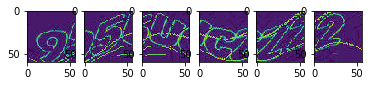

kcqn9c


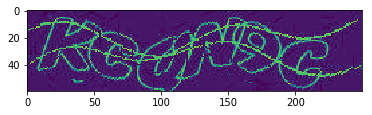

kcqn9c


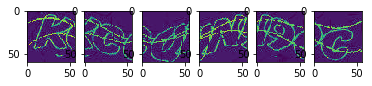

ucgqak


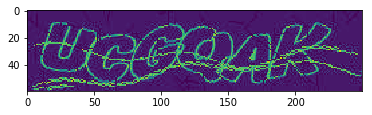

ucgqak


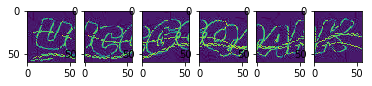

qchyez


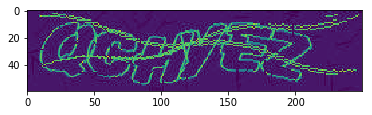

qchyez


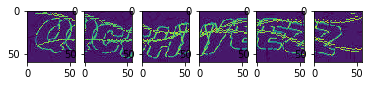

avhq3y


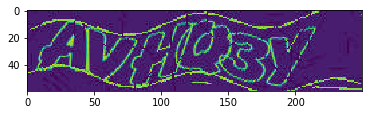

avhq3y


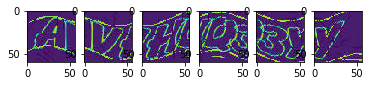

2n6d6z


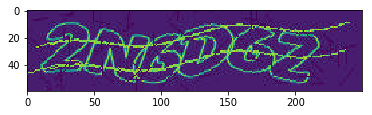

2n6d6z


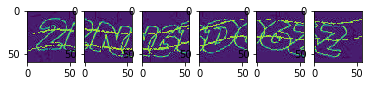

pevm9q


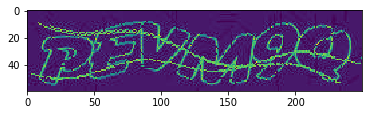

pevm2g


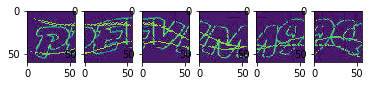

sq6sqk


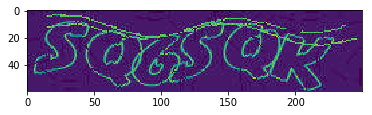

sq6sqk


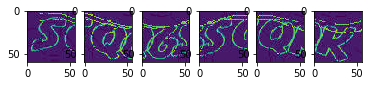

9gcvk9


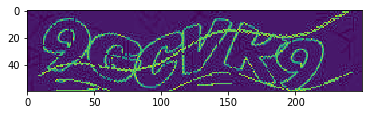

9gcvk9


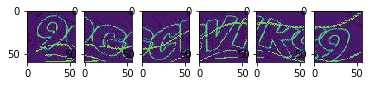

3sn3hz


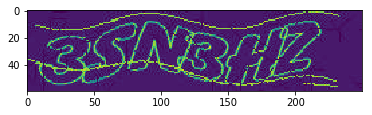

3sn3hz


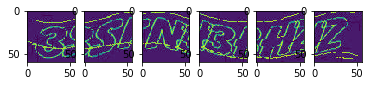

mzk8ad


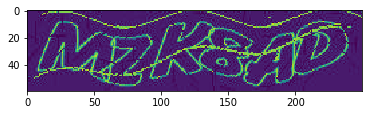

mzk8ag


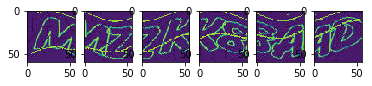

277917


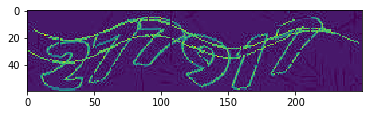

277917


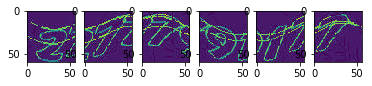

9czamc


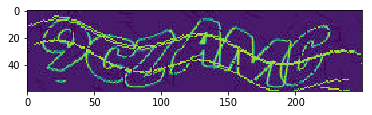

9czavc


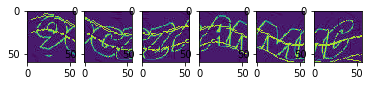

5c3a6k


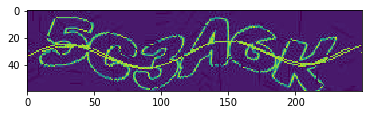

5c3a6k


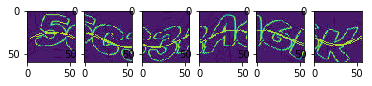

n9x8xz


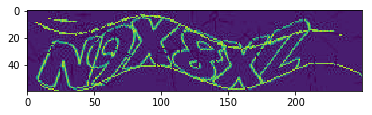

n9x8xz


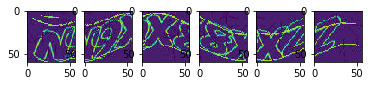

zsey56


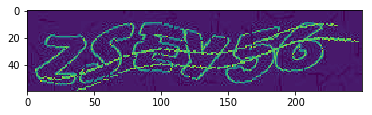

zsey56


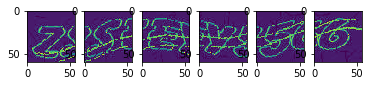

d8dnnk


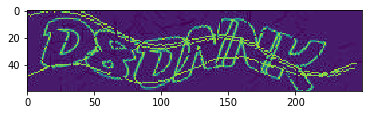

d8dnnk


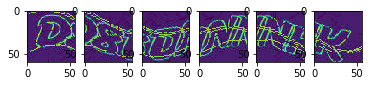

ue5848


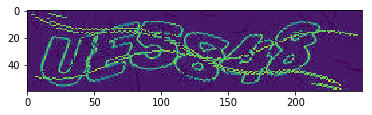

ue5848


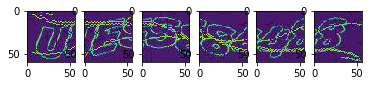

685778


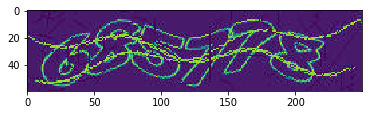

685778


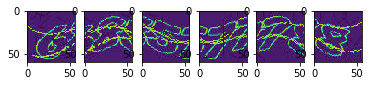

yvaq59


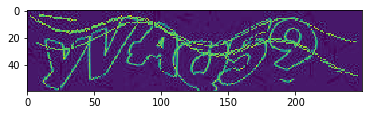

yvaq59


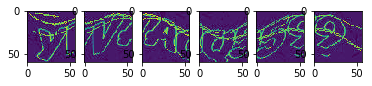

9ken3x


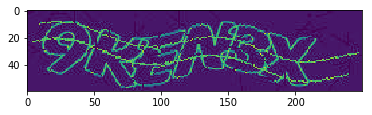

9ken3x


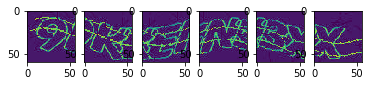

eug6yn


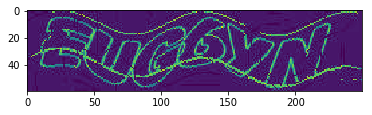

eug6yn


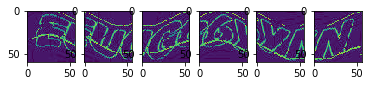

896269


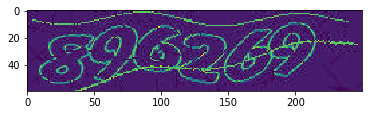

896269


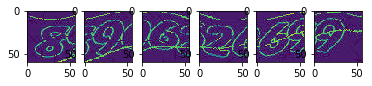

496186


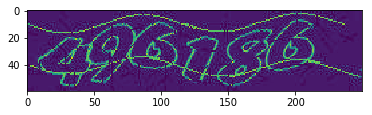

496186


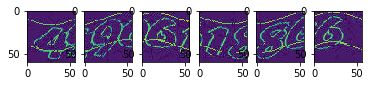

dnn83x


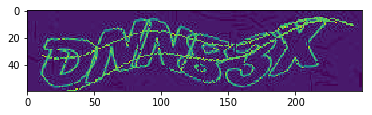

dnn83x


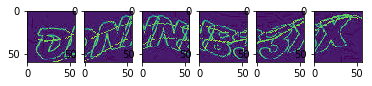

6duuka


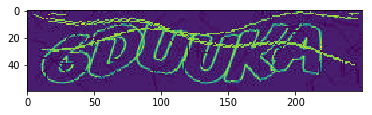

6duuka


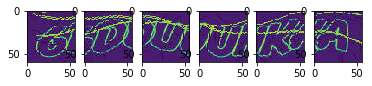

xsn9da


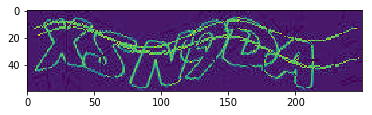

xsn9da


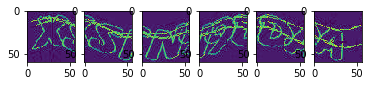

zxzs3e


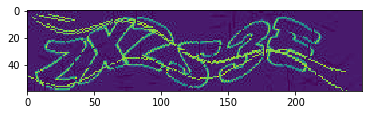

zxzs3e


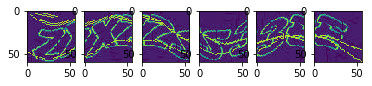

masn5k


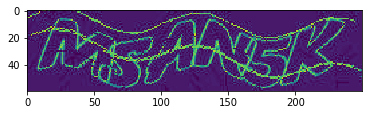

masn5k


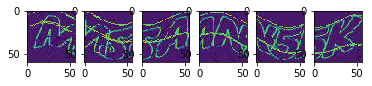

c3pe2s


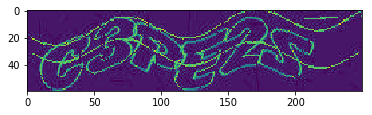

c3pe2s


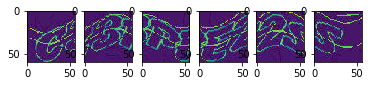

z4v3q5


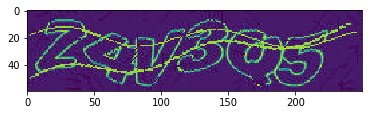

z4v3q5


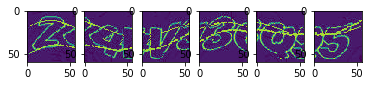

985411


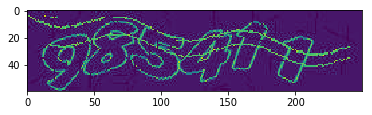

985411


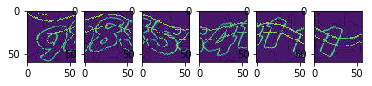

kmhdyy


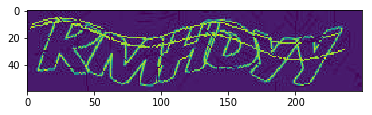

kmhdyy


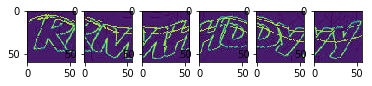

aq945g


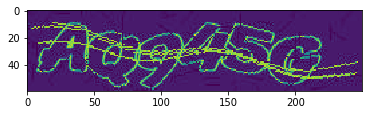

aq945g


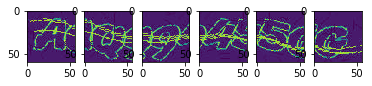

vc2xz4


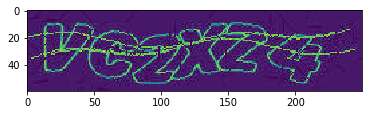

vc2xz4


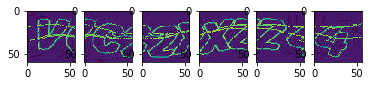

9eyxx5


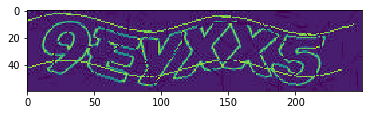

9eyxx5


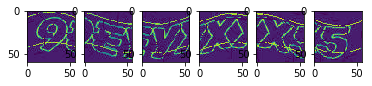

qk9sy9


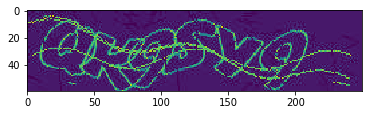

qk9sy9


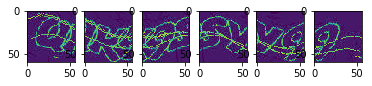

4qzzam


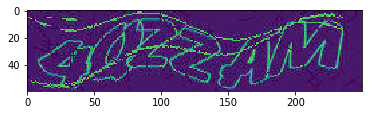

4qzzam


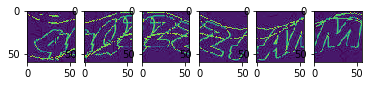

974166


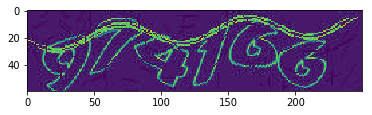

974166


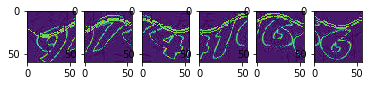

neqv8m


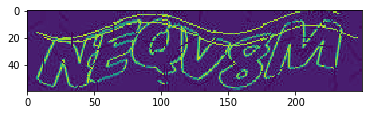

neqv8m


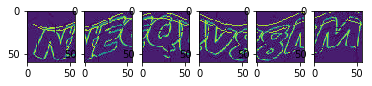

k8z28s


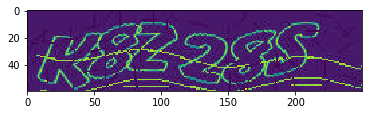

k8z28s


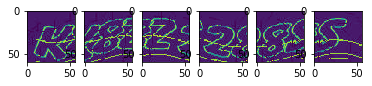

798514


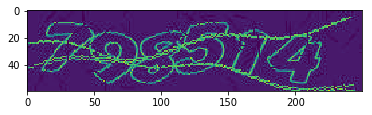

798514


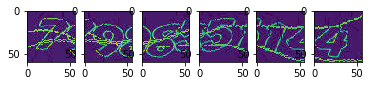

pchm8z


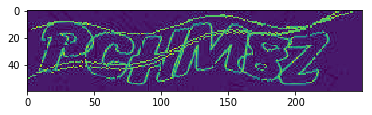

pchm8z


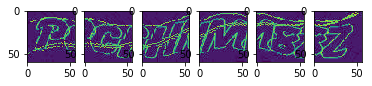

964639


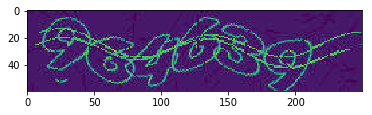

964639


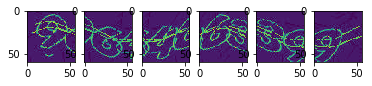

psav9h


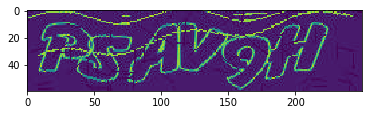

psav9h


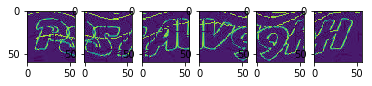

vxhdka


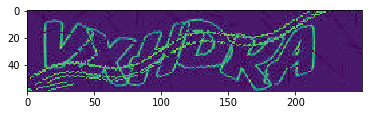

vxhdka


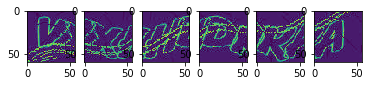

996444


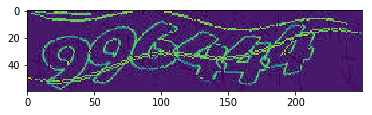

996444


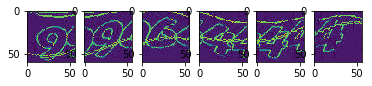

vg4nn4


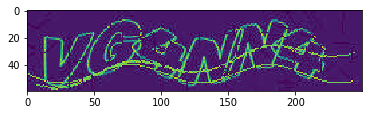

vg4nn4


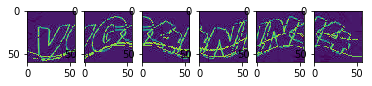

a2qzds


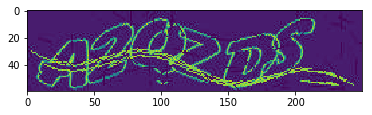

a2qzds


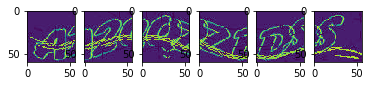

462951


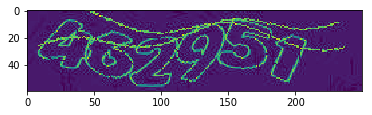

462951


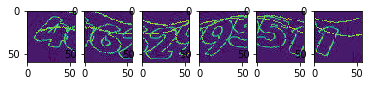

x6peh4


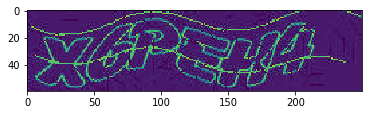

x6peh4


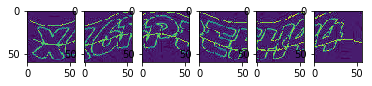

44g268


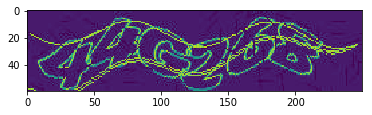

44g268


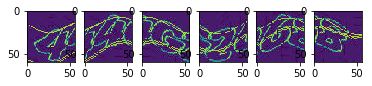

g434x8


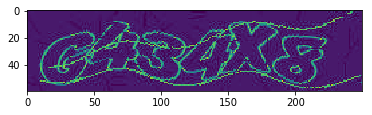

g434x8


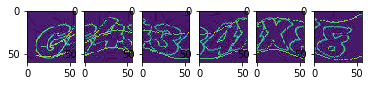

529777


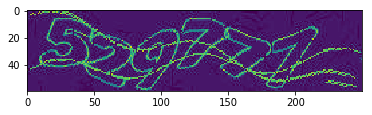

529777


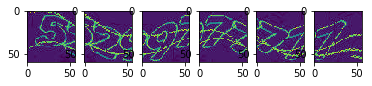

p95uha


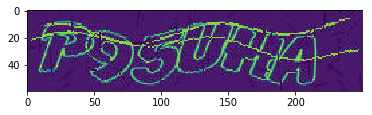

p95uha


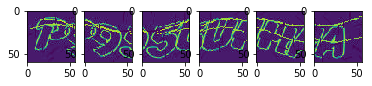

113156


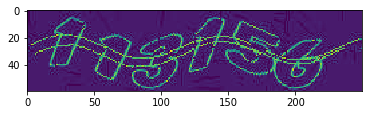

113156


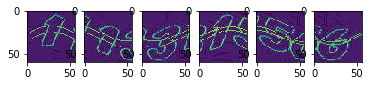

554773


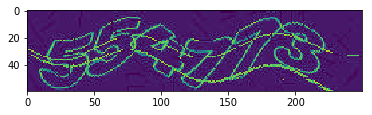

554773


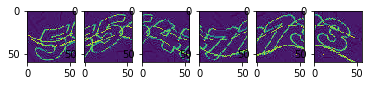

341327


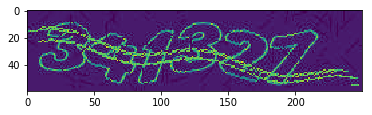

341327


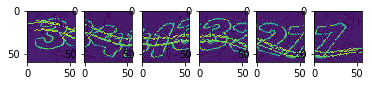

298446


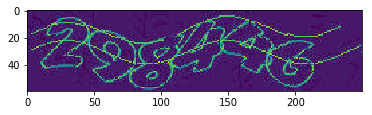

298446


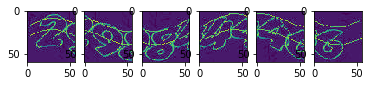

9u8aud


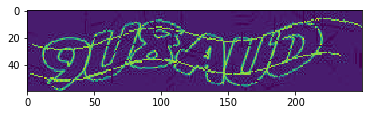

9u8aud


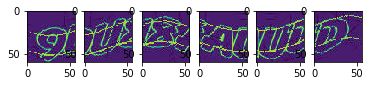

v64xs3


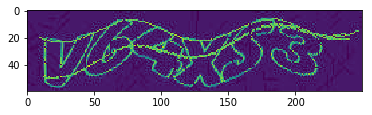

v64xs3


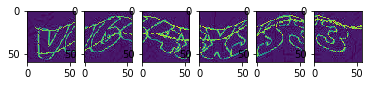

253657


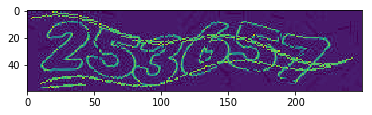

253657


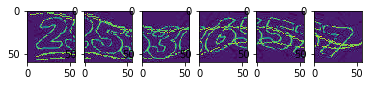

936153


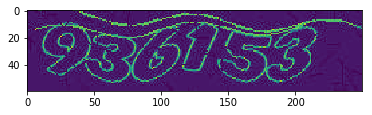

936153


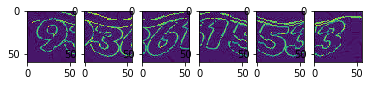

x6xg56


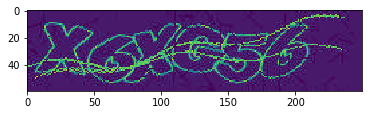

x6xg5s


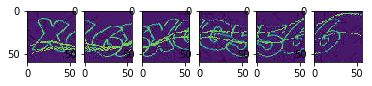

gq9hc4


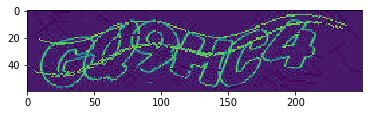

gq9hc4


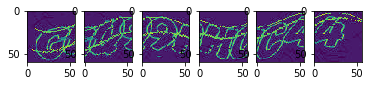

888497


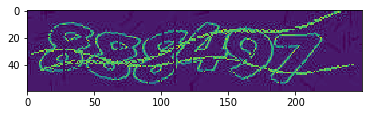

888497


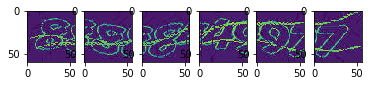

25p9qc


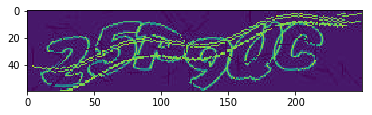

25p9qc


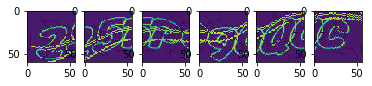

ymquuh


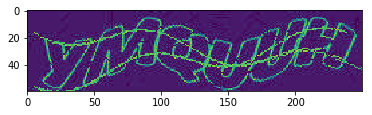

ymquuu


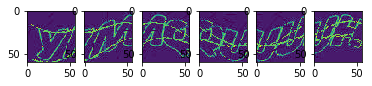

654696


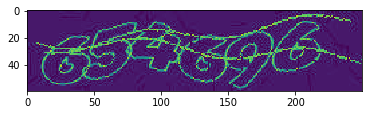

654696


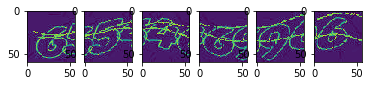

z4ppk8


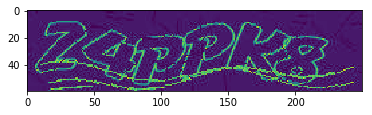

z4ppk8


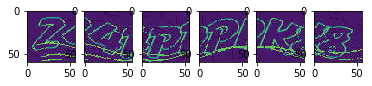

hdm4y3


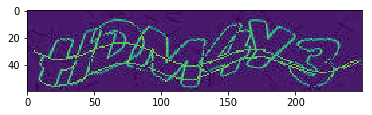

hdm4y3


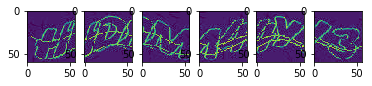

xzhhme


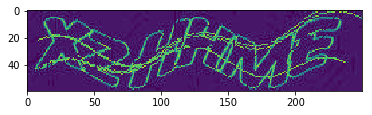

xzhhme


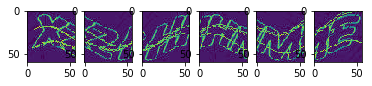

eq6u56


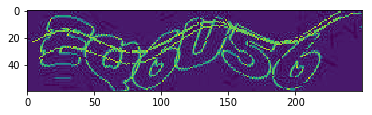

eq6u56


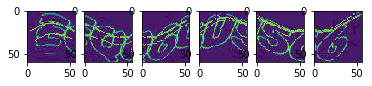

uvuqga


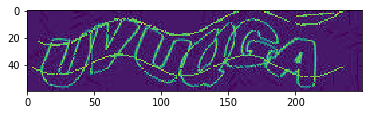

uvuqga


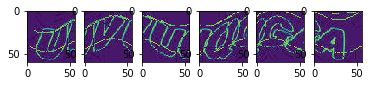

217766


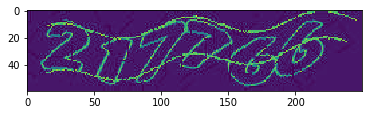

217766


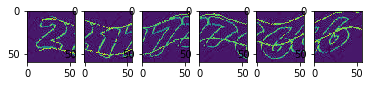

23dehy


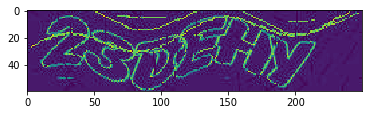

23dehy


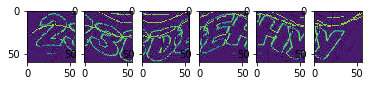

n8ka99


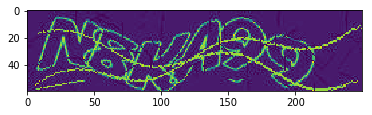

n8ka99


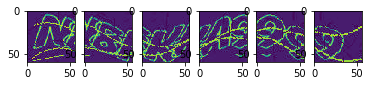

866413


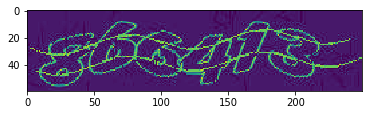

866413


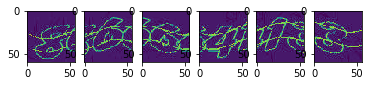

nh8qxa


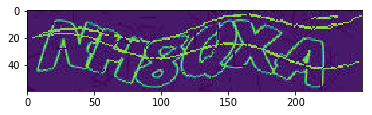

nh8qxa


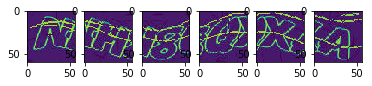

aqkx48


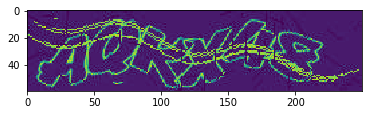

aqkx48


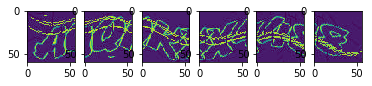

144958


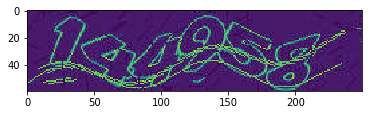

144958


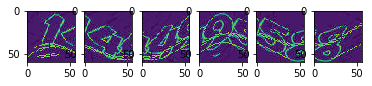

5u3pqk


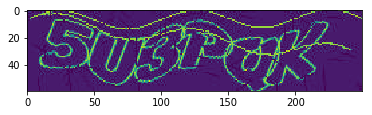

5u3pqk


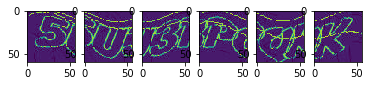

ge6em9


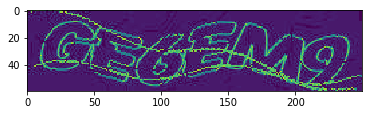

ge6em9


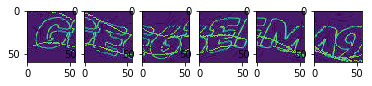

kxcgkq


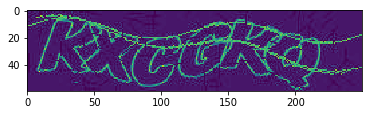

kxcgkq


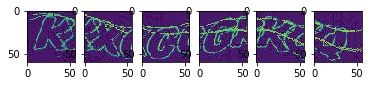

e3su5e


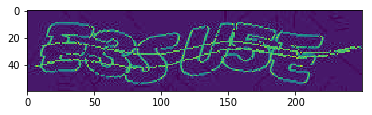

e3su5e


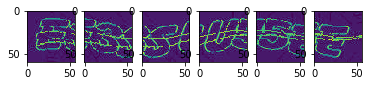

gyky8n


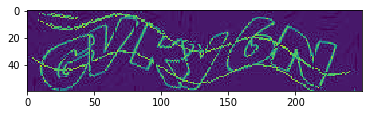

gyky8n


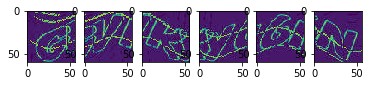

44k8ny


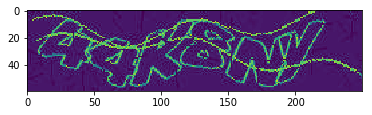

44k8ny


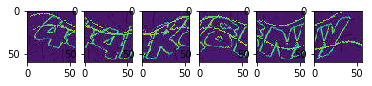

816531


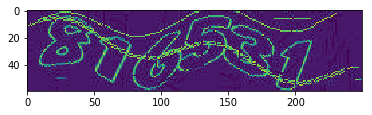

816531


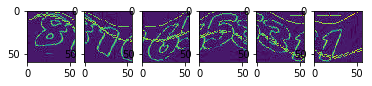

e883xp


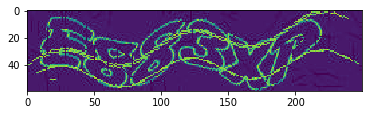

e883xp


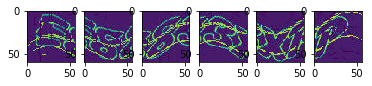

935317


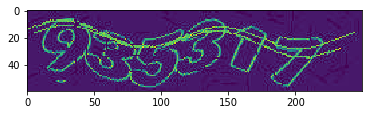

935317


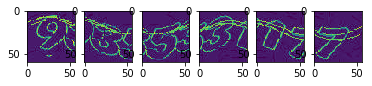

qyced6


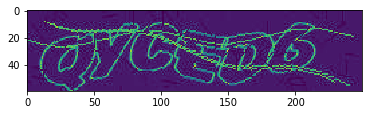

qyced6


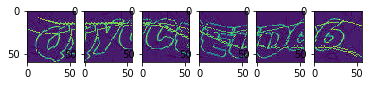

yynaed


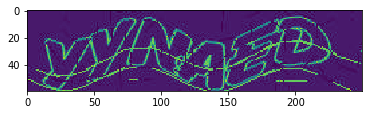

yynaed


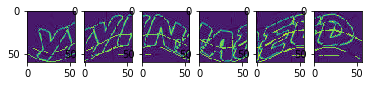

megm24


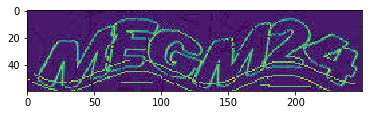

megm24


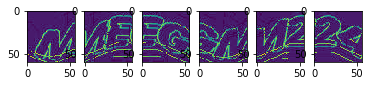

714267


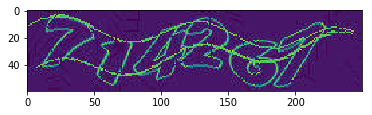

714267


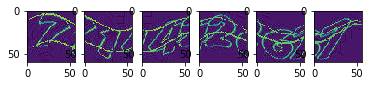

24d46g


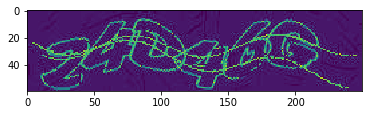

24d46g


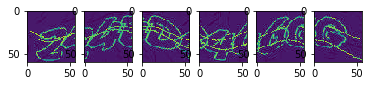

171672


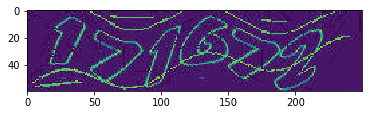

171672


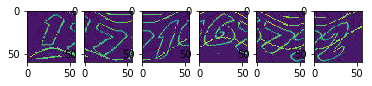

682576


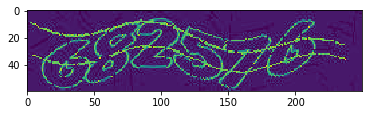

6825z6


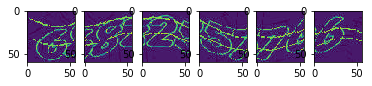

kdke9z


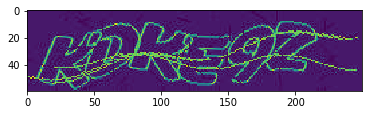

kdke9z


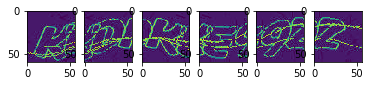

vqnqxk


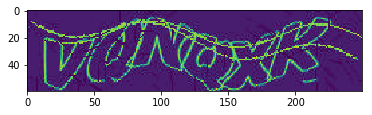

vcnqxk


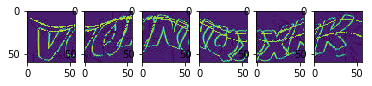

gvgs3z


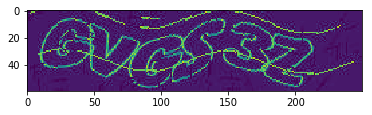

gvgs3z


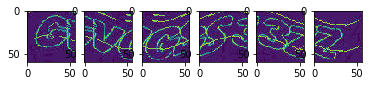

183625


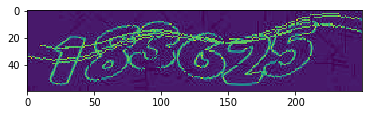

183625


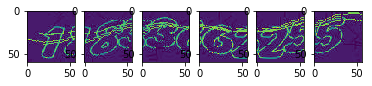

289561


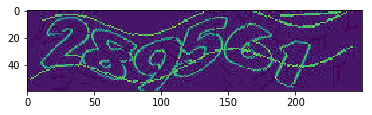

289561


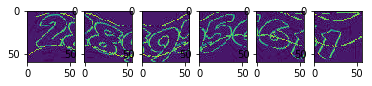

767673


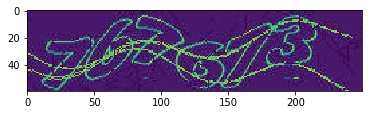

767673


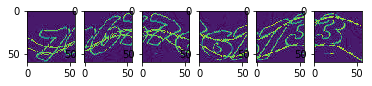

dazam9


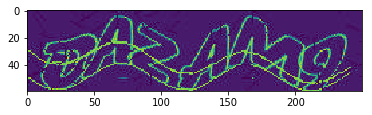

dazam9


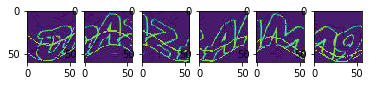

6qxh44


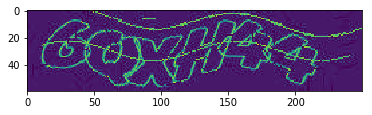

6qxh44


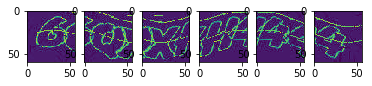

gedm88


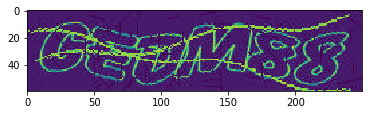

cedm88


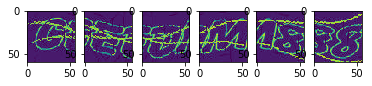

4xcn8g


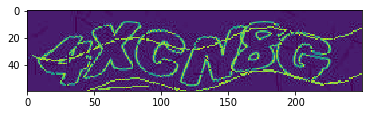

4xcn8g


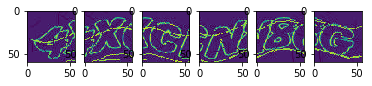

sukkp8


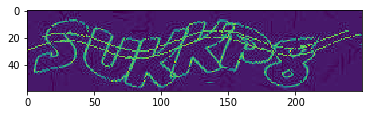

sukkp8


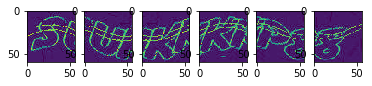

795119


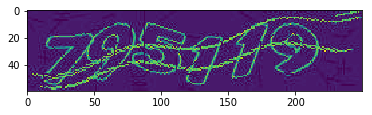

795119


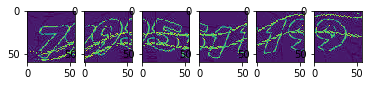

24pxhe


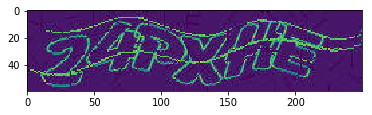

24pxhe


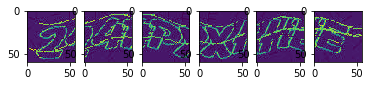

474388


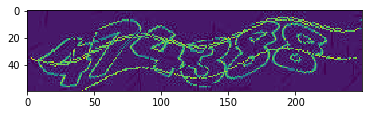

474388


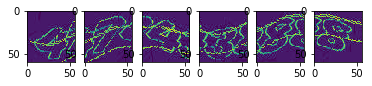

exm6x4


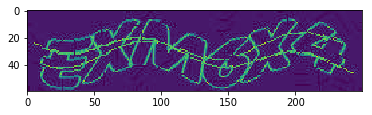

exmzd4


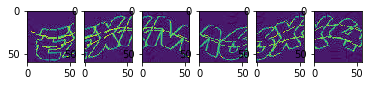

2ekxnz


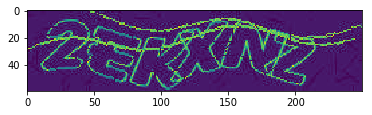

2ekxnz


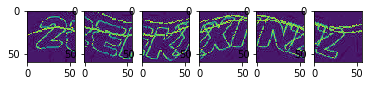

zs9exn


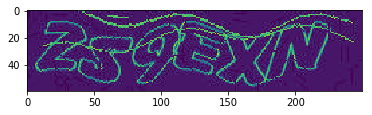

zs9exn


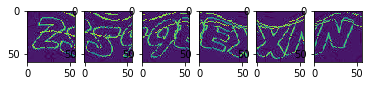

796969


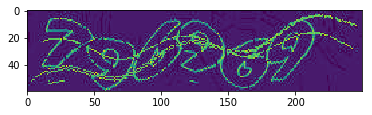

796969


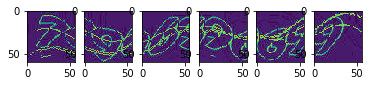

85yvdc


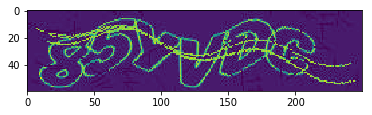

85yvdc


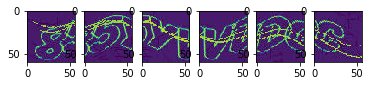

955678


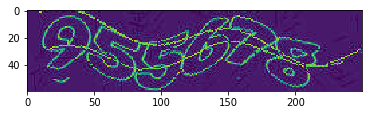

955678


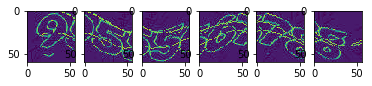

gp3vh6


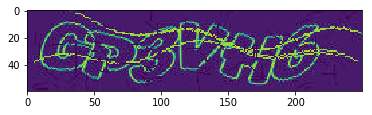

gp3vh6


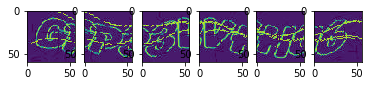

455226


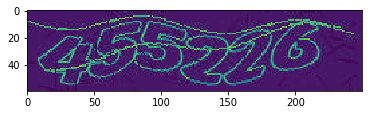

455226


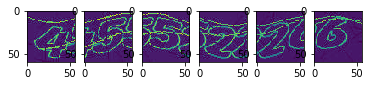

9hhh6x


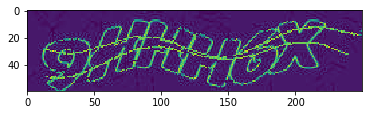

9hhh6x


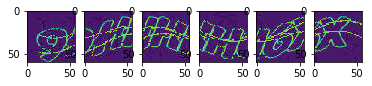

8zmamu


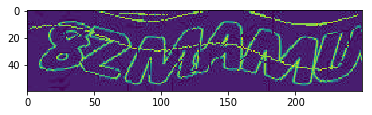

8zmamu


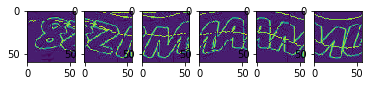

hym4hy


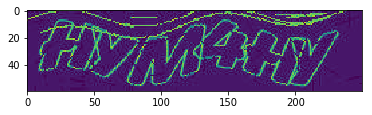

hym4hy


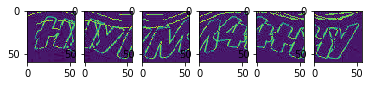

735556


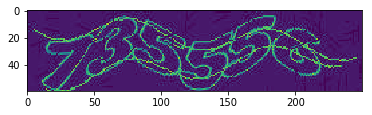

735556


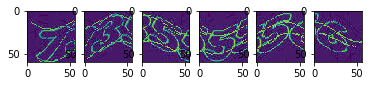

837764


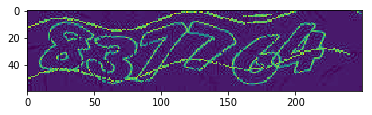

837764


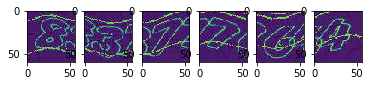

z6y6sp


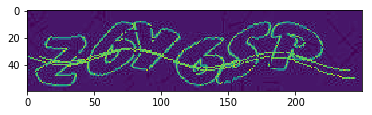

z6y6sp


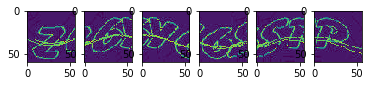

5uv8hm


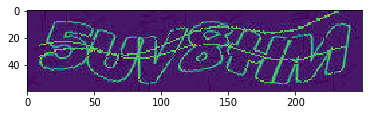

5uv8hm


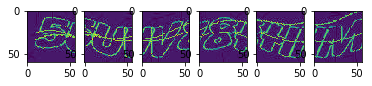

584654


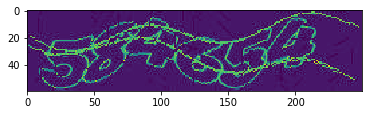

584654


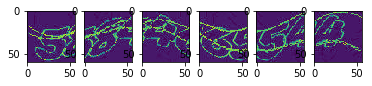

398783


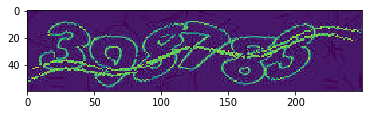

398783


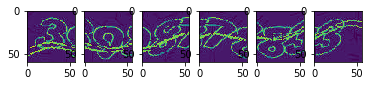

8vzeey


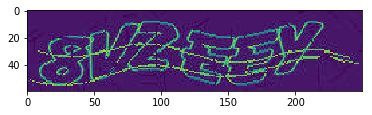

8vzeey


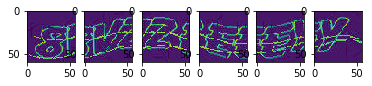

239398


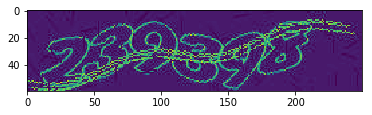

239398


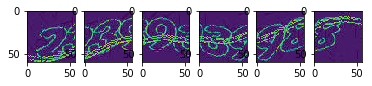

2a2ssy


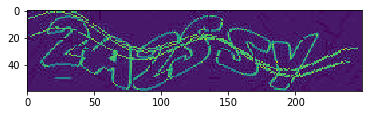

2a2ssq


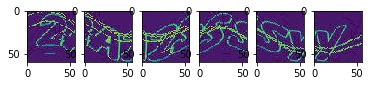

zeh25d


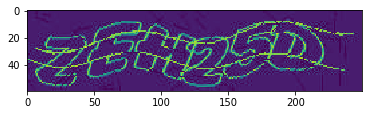

zeh25d


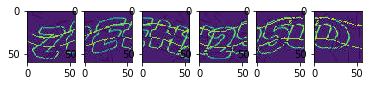

sd25pk


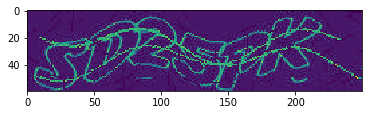

sd25pk


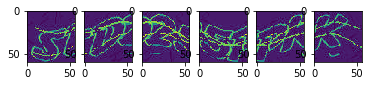

9xcqcc


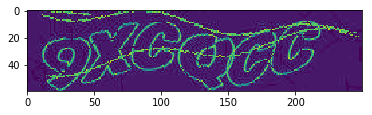

9xcqcc


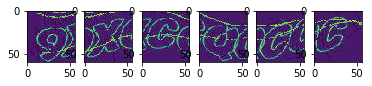

8ccaym


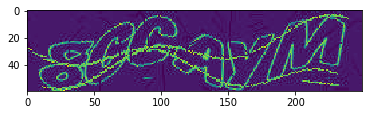

8ccaym


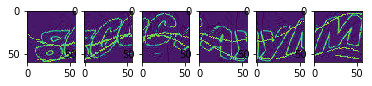

636314


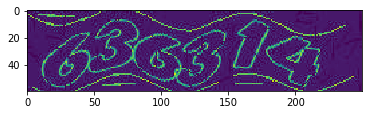

636314


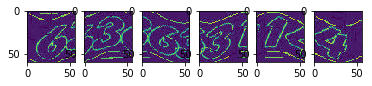

a6qe6p


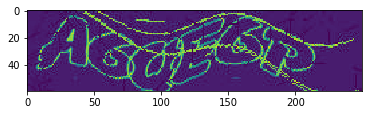

a6qeqp


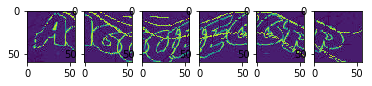

gh33md


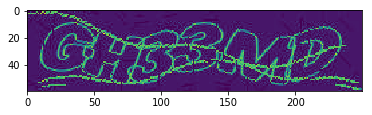

gh33md


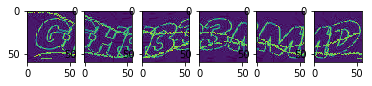

34yh9u


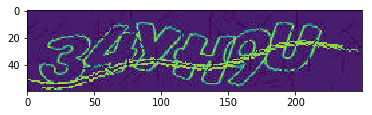

34yh9u


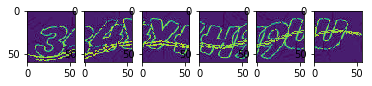

kxehz2


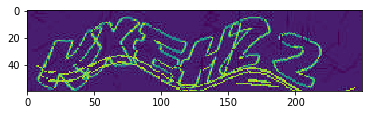

kxehz2


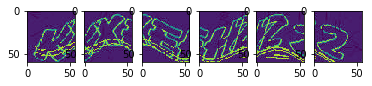

8865na


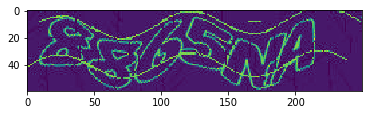

8865na


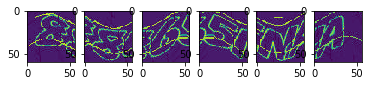

231498


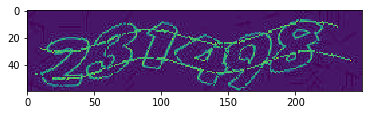

231498


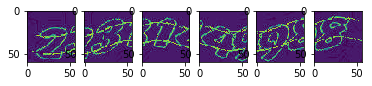

3s2xqg


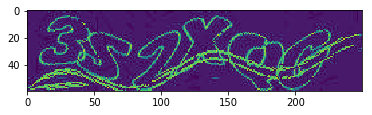

3s2xqg


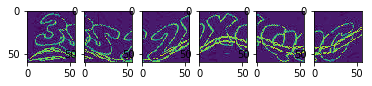

a6d9v2


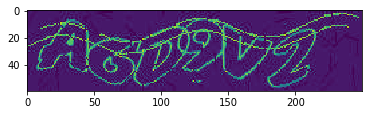

a6d9v2


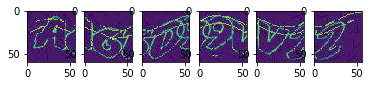

5pdddc


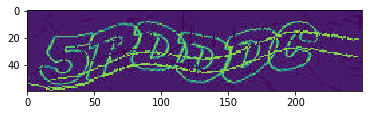

5pdddc


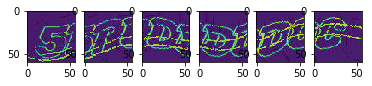

8z534p


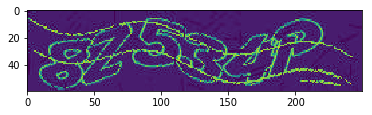

8z534p


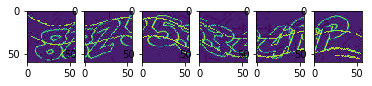

6sqqy6


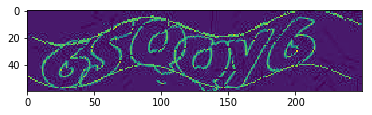

6sqqy6


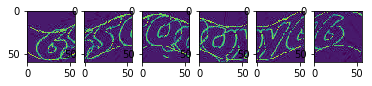

9h9gvq


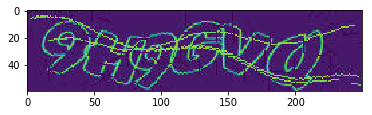

9h9gvq


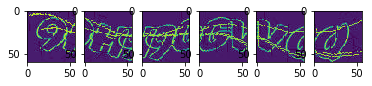

68dxk9


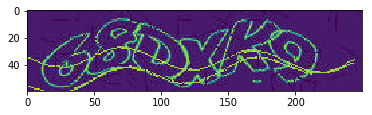

68dxk9


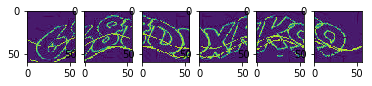

vymyn6


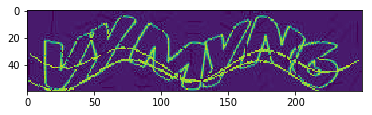

vymyn6


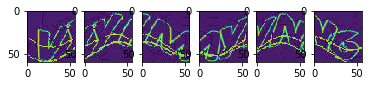

zkpsvn


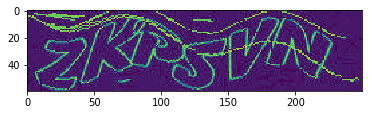

zkpsvn


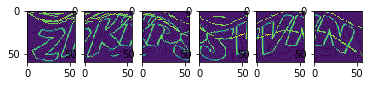

511671


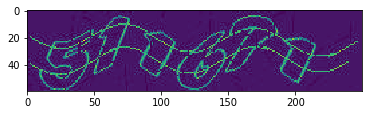

511671


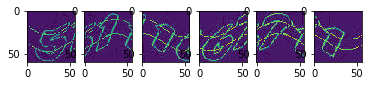

pyxkhe


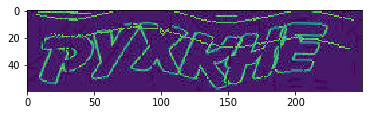

pyxkhe


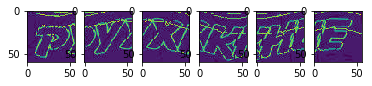

5p8m9z


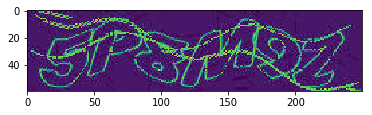

5p8m9z


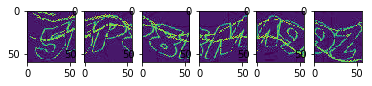

3mnuey


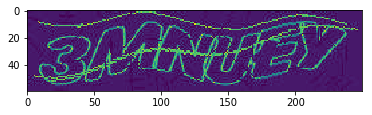

3m1uey


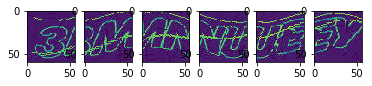

u85zdd


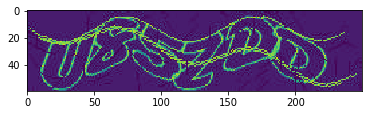

u85zdd


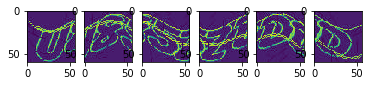

4cqvup


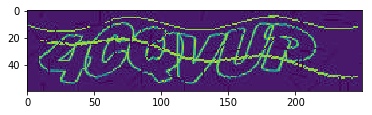

4cqvup


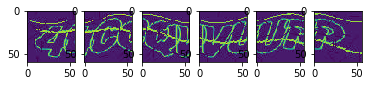

6dzg88


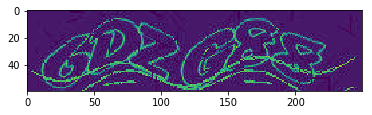

6dzg88


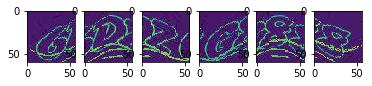

845mcu


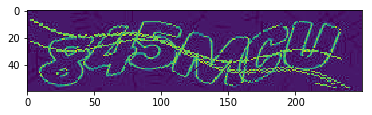

845mcu


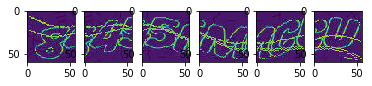

567241


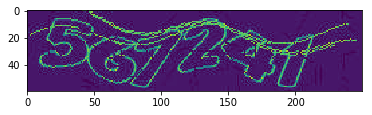

567241


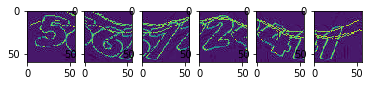

kudshc


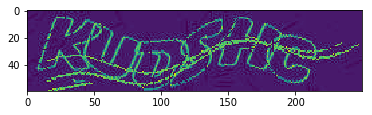

kudshc


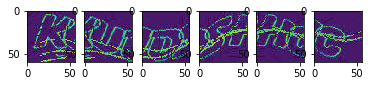

6sgh5n


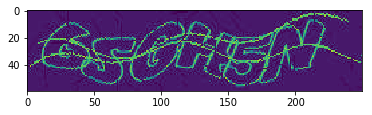

6sgh5n


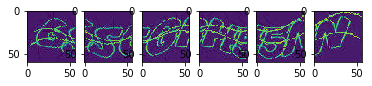

441899


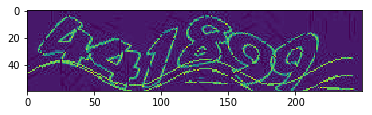

441899


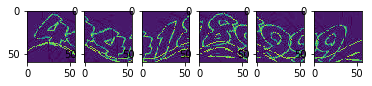

334734


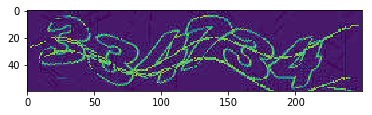

334734


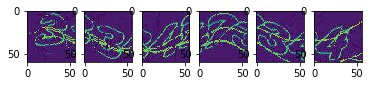

653799


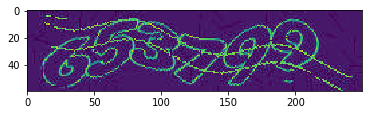

653799


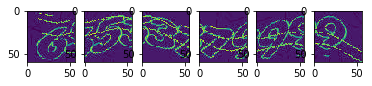

ahnadz


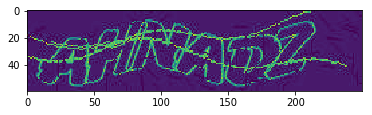

ahnadz


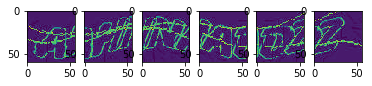

n9zaqd


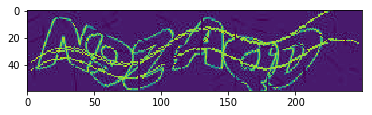

n9zaqd


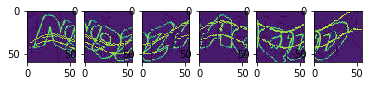

yk4ds5


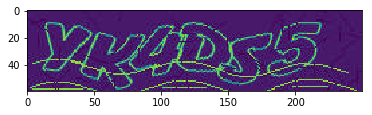

yk4ds5


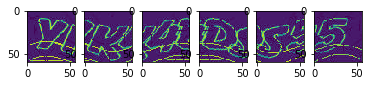

3pgcas


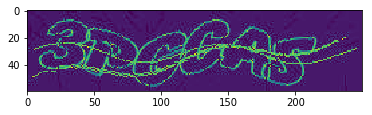

3pgcas


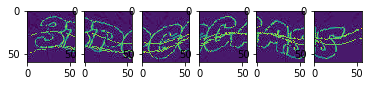

gun4m8


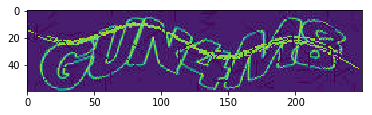

gun4m8


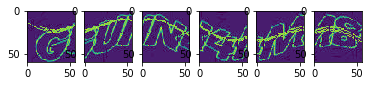

x9mn9n


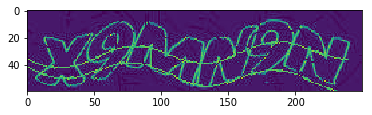

x9mn9n


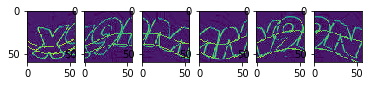

819919


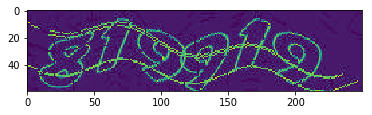

819919


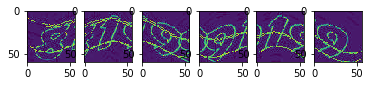

683423


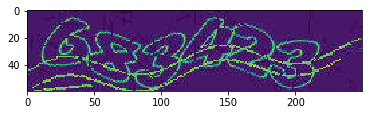

683423


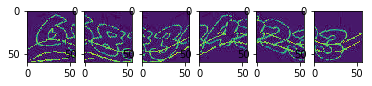

nx599e


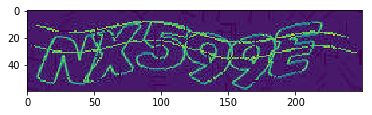

nx599e


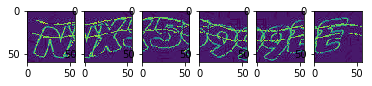

727342


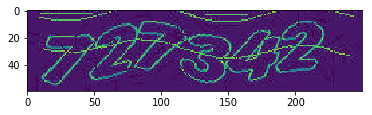

727342


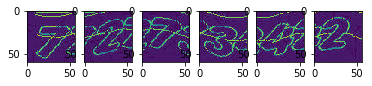

g4haq5


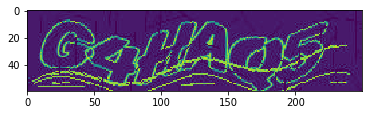

g4haq5


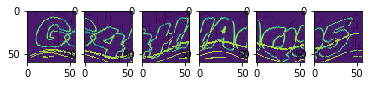

44ynsz


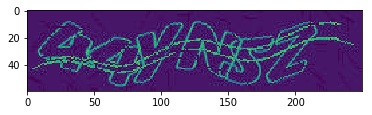

44ynsz


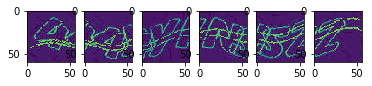

398gez


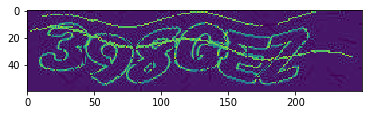

398gez


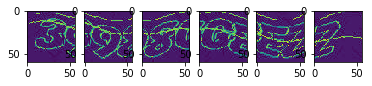

xsh24h


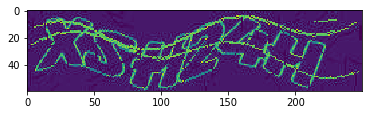

xsh24h


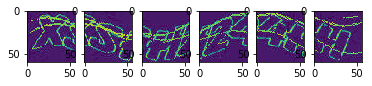

cgc4y6


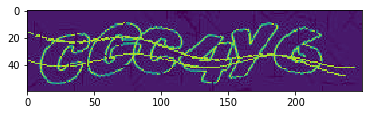

cgc4y6


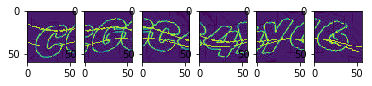

484652


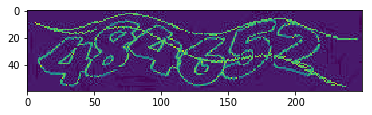

484652


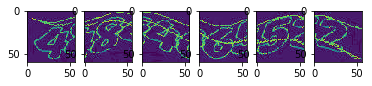

zye5yq


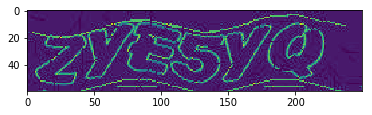

zye5yq


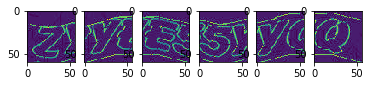

sdq9e8


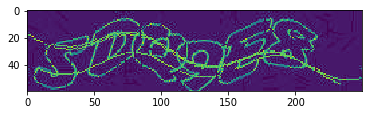

sdq9e8


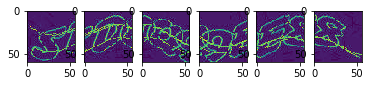

938134


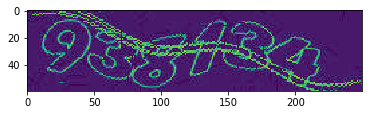

938134


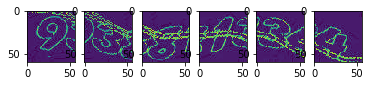

186729


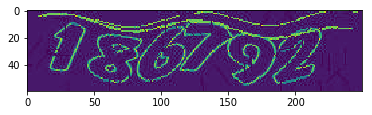

186792


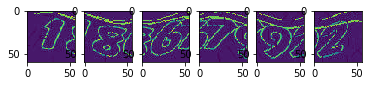

k44czq


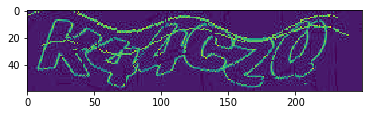

k44czq


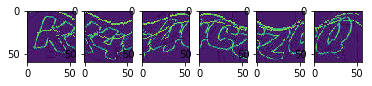

55cn25


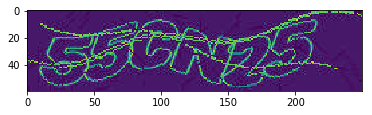

55cn25


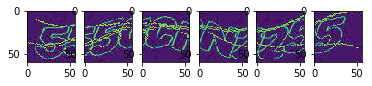

919918


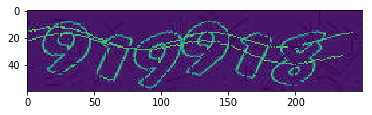

919918


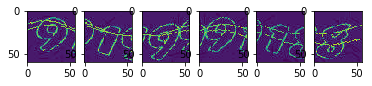

2n4gmn


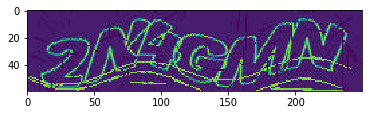

2n4gvn


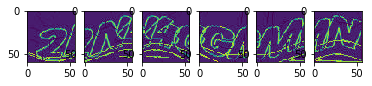

mqzudy


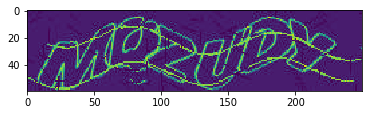

mqzudy


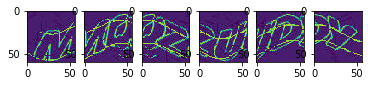

498333


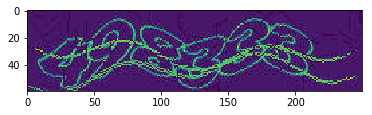

498333


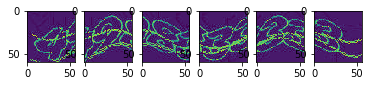

v6yv9k


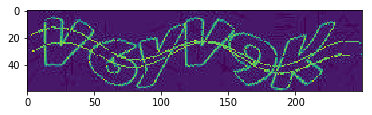

v6yv9k


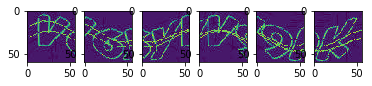

4e8xne


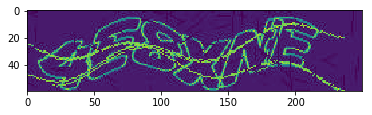

4e8xne


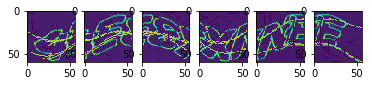

334255


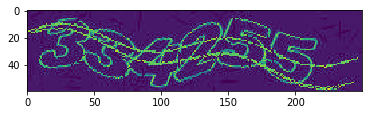

334255


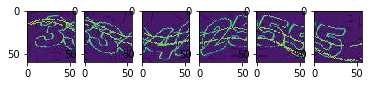

gazaye


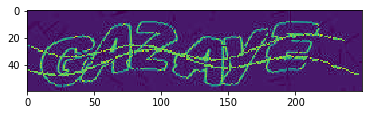

gazaye


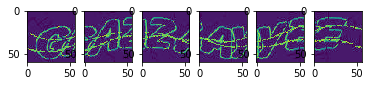

221664


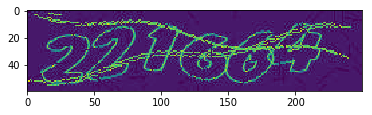

221664


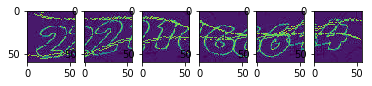

9ca2ya


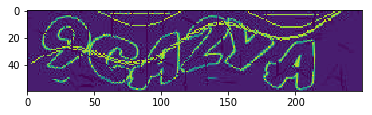

9ca2ya


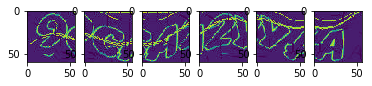

vsuz93


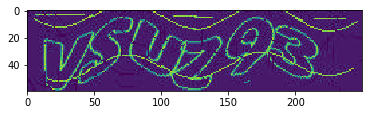

vsuz93


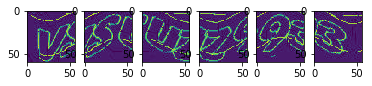

127287


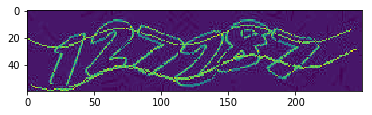

127287


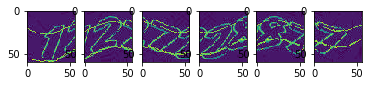

695691


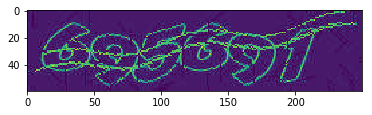

695691


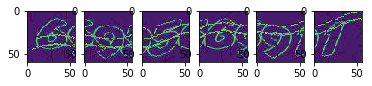

y45dd8


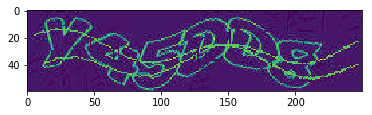

y45dd8


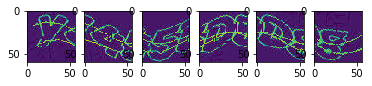

196316


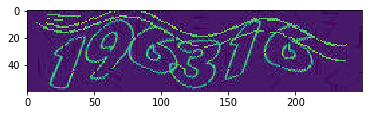

196316


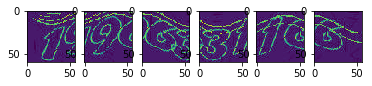

9ak3g5


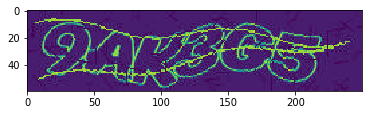

9ak3g5


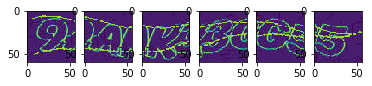

372969


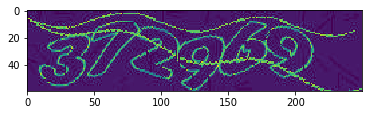

372969


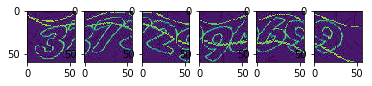

88x5ep


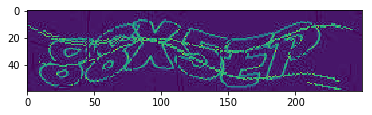

88x5ep


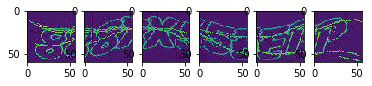

462896


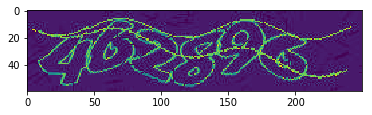

462896


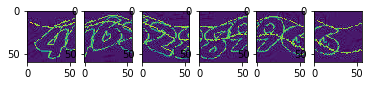

nhd3g5


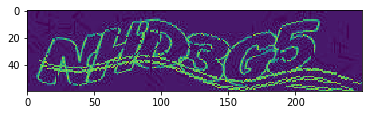

nhd3g5


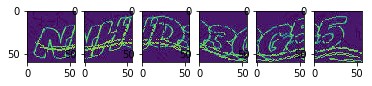

412626


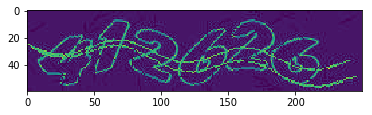

412626


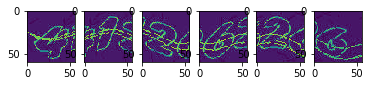

ucavsu


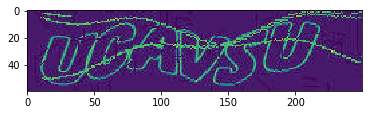

ucavsu


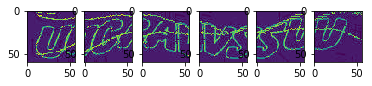

vx42hq


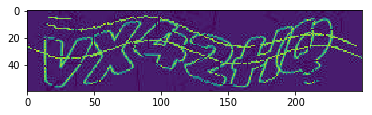

vx42hq


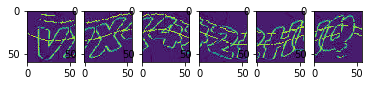

nphzmp


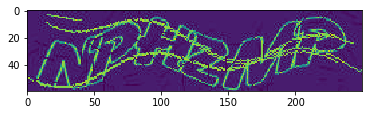

nphzmp


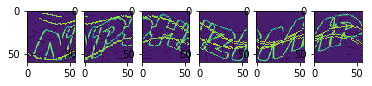

d45d92


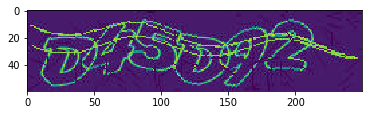

d45d92


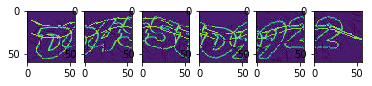

denkgz


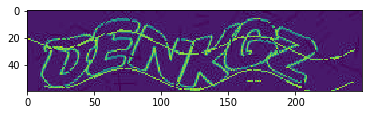

denkgz


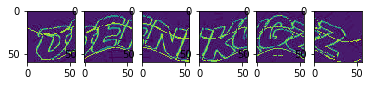

hv5vg8


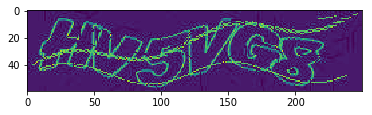

hv5vg8


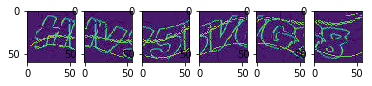

ad3u24


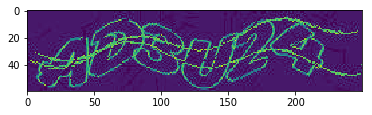

ad3u24


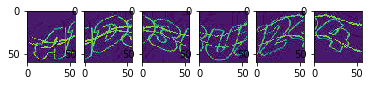

ez343n


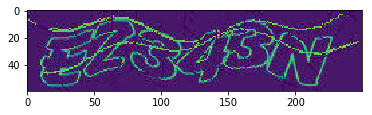

ez343n


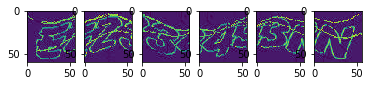

xdqqkh


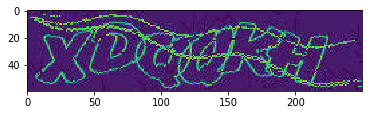

xdqqkh


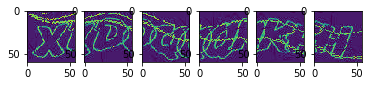

869344


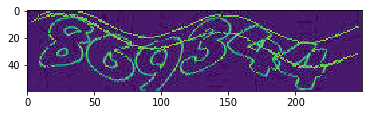

869344


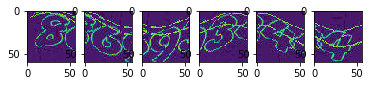

398221


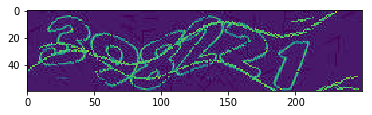

3982z1


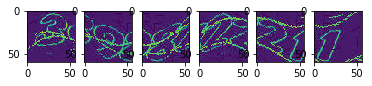

926484


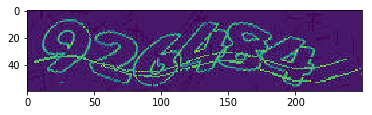

926484


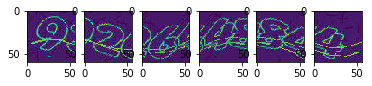

689642


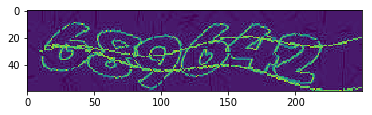

689642


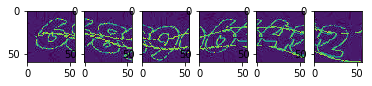

vd3ggh


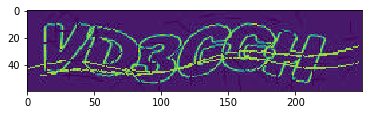

vd3ggh


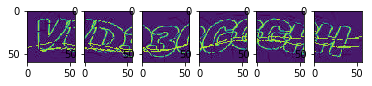

524154


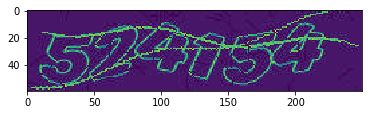

524154


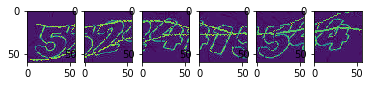

capvgq


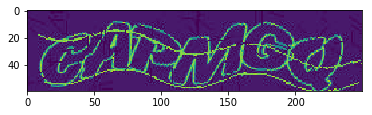

capvgq


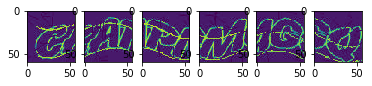

dya5k6


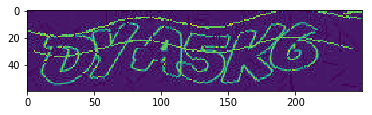

dya5k6


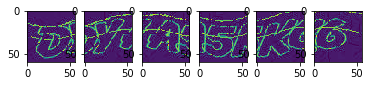

5h3em8


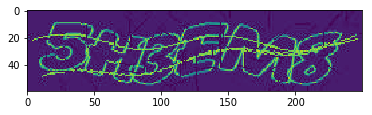

5h3em8


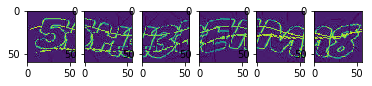

5ey6yn


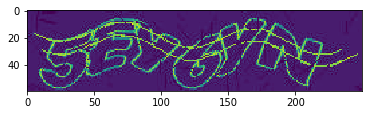

5ey6yn


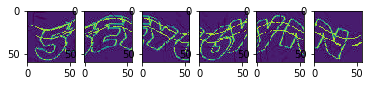

gg8mag


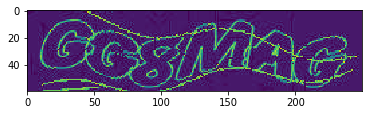

gg8mag


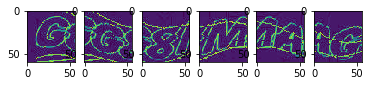

329575


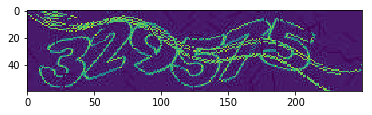

329575


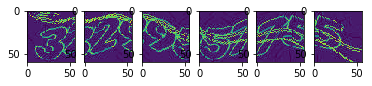

645658


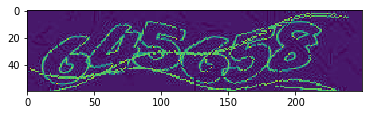

645658


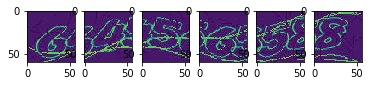

In [87]:
new_shape = 60,50

loc = 'images/full'
folder = os.listdir(loc)

for image in folder:
    labels = image[:-4]
    if len(labels)!=6: continue

        
    image = loc + '/' + image
    im = cv2.imread(image)
    a = np.asarray(im)
    a = a[:,:,0]
    a = a/255
    a = 1-a
    
    if a.shape[0]!=60: continue;
    
    l = 10
    r = 230
    s = int((r-l)/6)
    print(labels)
    plt.imshow(a)
    plt.show()
    fig, ax = plt.subplots(1,6)
    captcha = ""
    for i in range(6):
        img = np.array(a[:, l + i*s-10: l + (i+1)*s + 10])    
        ax[i].imshow(img)
        captcha += decode(model.predict(img.reshape(1,60,56,1)).argmax(axis=1))
    print(captcha)
    plt.show()



In [104]:
model.save('captcha_model.h5')

In [84]:
1



1